In [2]:
import pandas as pd
import time
import numpy as np
import struct
import matplotlib.pyplot as plt
from cr_data_inspection_functions import *
from lwa_antpos import mapping
from scipy.optimize import curve_fit
import math

Read antpos from xlsx file in repo


## Overview
This notebook is a first look at the data I collected in a first overnight observing run.

To do next:


make a summary pdf with 1 page per event and look at ~50 events this way


## Load The First ~10 Events

In [3]:
#array_map=pd.read_csv('array-map-5-15-23.csv')
array_map=pd.read_csv('array-map-5-22-2023.csv')
xdict={}
ydict={}
zdict={}
for i,n in enumerate(array_map['antname']):
    xdict[n]=array_map['x'][i]
    ydict[n]=array_map['y'][i]
    zdict[n]=array_map['elevation'][i]


In [4]:
fname = '/data1/cosmic-ray-data/2023May3/overnight1683180610.6110308.dat'
records = parsefile(fname, end_ind = 704*10)

Text(0.5,0,'Time [clock cycles]')

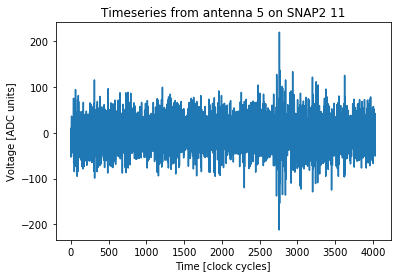

In [5]:
#plot an example timeseries
first_timeseries=records[100]['data']
fpga_id=records[100]['board_id']
antenna=records[100]['antenna_id']
plt.plot(first_timeseries)
plt.title('Timeseries from antenna '+str(antenna)+' on SNAP2 '+ str(fpga_id))
plt.ylabel('Voltage [ADC units]')
plt.xlabel('Time [clock cycles]')

In [6]:
timestamps=[record['timestamp'] for record in records]

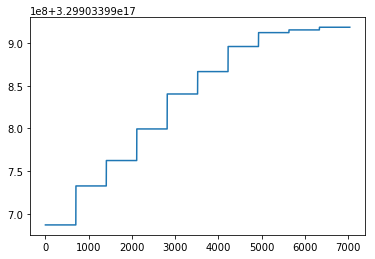

In [7]:
plt.plot(timestamps)

In [8]:

def distinguishevents2(records,maxoffset):
    #This function turns a list of single-antenna records, into a list of events.
    #records is a list of single-antenna records, such as that returned by parsefile.
    #maxoffset is the maximum timestamp difference (in number of clockcycles) for two records to be considered part of the same event.
    #The function distinguish events returns a list of events, where each event is a list of indices of the records (single-antenna dictionaries) that belong to that event, and a list of the records themselves.

    #start an empty list which will ultimately have one element per event
    events=[]
    #eventcount=1  #keep track of how many separate events there are

    #start an list for the first event. The first record is the first element of the first event
    currentevent_records=[]
    currentevent_indices=[]

    currenteventtimestamp=records[0]['timestamp']

    maxtimestamp=currenteventtimestamp+maxoffset #all
    mintimestamp=currenteventtimestamp-maxoffset
    for i,record in enumerate(records):
        recordtimestamp=record['timestamp']
        if mintimestamp<recordtimestamp<maxtimestamp:
            #print(recordtimestamp, maxtimestamp,True)
            currentevent_records.append(record)
            currentevent_indices.append(i)
        else: #start a new event
            #print(recordtimestamp, maxtimestamp,False)
            #eventcount+=1
            events.append([currentevent_records,currentevent_indices])
            currentevent_records=[record]
            currentevent_indices=[i]

            currenteventtimestamp=record['timestamp']
            maxtimestamp=currenteventtimestamp+maxoffset
    events.append([currentevent_records,currentevent_indices])
    return events


def distinguishevents(records,maxoffset):
    #This function turns a list of single-antenna records, into a list of events.
    #records is a list of single-antenna records, such as that returned by parsefile.
    #maxoffset is the maximum timestamp difference (in number of clockcycles) for two records to be considered part of the same event.
    #The function distinguish events returns a list of events, where each event is a list of indices of the records (single-antenna dictionaries) that belong to that event.

    #start an empty list which will ultimately have one element per event
    events=[]
    #eventcount=1  #keep track of how many separate events there are

    #start an list for the first event. The first record is the first element of the first event
    #currentevent_records=[]
    currentevent_indices=[]

    currenteventtimestamp=records[0]['timestamp']

    maxtimestamp=currenteventtimestamp+maxoffset #all
    mintimestamp=currenteventtimestamp-maxoffset
    for i,record in enumerate(records):
        recordtimestamp=record['timestamp']
        if mintimestamp<recordtimestamp<maxtimestamp:
            #print(recordtimestamp, maxtimestamp,True)
            #currentevent_records.append(record)
            currentevent_indices.append(i)
        else: #start a new event
            #print(recordtimestamp, maxtimestamp,False)
            #eventcount+=1
            events.append(currentevent_indices)
            #currentevent_records=[record]
            currentevent_indices=[i]

            currenteventtimestamp=record['timestamp']
            maxtimestamp=currenteventtimestamp+maxoffset
    events.append(currentevent_indices)
    return events

In [9]:
def mergepolarizations(event):
    for record in event:
        record['antname']=mapping.snap2_to_antpol(record['board_id'],record['antenna_id'])

    merging=[record for record in event if record['antname'][-1]=='A']
    polB=[record for record in event if record['antname'][-1]=='B']

    mergedrecords=[]
    for record in merging:
        newrecord={} #make a new dictionary to merge the polarizations together
        # Information that is the same for both polarizations can be filled in from the PolA record
        antname=record['antname'][:-1]
        newrecord['antname']=antname
        newrecord['x']=xdict[antname]
        newrecord['y']=ydict[antname]
        newrecord['z']=zdict[antname]
        newrecord['timestamp']=record['timestamp']
        newrecord['board_id'] = record['board_id']
        newrecord['this_board_triggered'] =  record['this_board_triggered']
        newrecord['coincidence_threshold'] =  record['coincidence_threshold'] 
        newrecord['veto_threshold'] =   record['veto_threshold'] 
        newrecord['trigger_power_threshold'] = record['trigger_power_threshold']
        newrecord['veto_power_threshold'] = record['veto_power_threshold']
        newrecord['coincidence_window'] = record['coincidence_window']
        newrecord['veto_coincidence_window'] = record['veto_coincidence_window'] 

        #Information that is specific to POl A
        newrecord['trigger_role_A'] = record['trigger_role']
        newrecord['antenna_id_A'] =  record['antenna_id'] 
        newrecord['veto_role_A'] = record['veto_role']
        Adata = record['data']
        newrecord['polA_data']=Adata
        newrecord['rmsA']=np.std(Adata)
        index_peak_A=np.argmax(np.abs(Adata))
        newrecord['index_peak_A'] =index_peak_A
        newrecord['peakA']=np.abs(Adata[index_peak_A]) 

        #find the polB data
        for Brecord in polB:
            if Brecord['antname'][:-1]==antname:
                #Information that is specific to POlB
                newrecord['trigger_role_B'] = Brecord['trigger_role']
                newrecord['antenna_id_B'] =  Brecord['antenna_id'] 
                newrecord['veto_role_B'] = Brecord['veto_role']
                Bdata = Brecord['data']
                newrecord['polB_data']=Bdata
                newrecord['rmsB']=np.std(Bdata)
                index_peak_B=np.argmax(np.abs(Bdata))
                newrecord['index_peak_B'] =index_peak_B
                newrecord['peakB']=np.abs(Bdata[index_peak_B])   

        mergedrecords.append(newrecord)
    return mergedrecords


In [10]:
start=time.time()
events=distinguishevents2(records,200)
testevent=events[3]
to_merge=testevent[0]
#testmerged=mergepolarizations(to_merge)
finish=time.time()
print(finish-start)



0.005290985107421875


In [11]:
start=time.time()
events=distinguishevents(records,200)
testevent_indices=events[5]
to_merge=[records[i] for i in testevent_indices]
#testmerged=mergepolarizations(to_merge)
finish=time.time()
print(finish-start)


0.003523588180541992


In [12]:
#make a list of events
events=distinguishevents(records,200)
for e in events:
    print(len(e))

704
704
704
704
704
704
704
704
704
704


## Examine one event in detail

In [13]:
event_indices=events[5]
event=[records[i] for i in event_indices]

mergedrecords=mergepolarizations(event)

rmsA=np.asarray([record['rmsA'] for record in mergedrecords])
peakA=np.asarray([record['peakA'] for record in mergedrecords])
index_peak_A=np.asarray([record['index_peak_A'] for record in mergedrecords])

rmsB=np.asarray([record['rmsB'] for record in mergedrecords])
peakB=np.asarray([record['peakB'] for record in mergedrecords])
index_peak_B=np.asarray([record['index_peak_B'] for record in mergedrecords])

xcoords=np.asarray([record['x'] for record in mergedrecords])
ycoords=np.asarray([record['y'] for record in mergedrecords])
zcoords=np.asarray([record['z'] for record in mergedrecords])
timestamps=np.asarray([record['timestamp'] for record in mergedrecords])
min_time=np.min(timestamps)


maximum_ok_rms=45
minimum_ok_rms=25

cutA = np.logical_and(rmsA >minimum_ok_rms, rmsA <maximum_ok_rms)
cutB = np.logical_and(rmsB >minimum_ok_rms, rmsB <maximum_ok_rms)

In [300]:
mergedrecords[0].keys()

dict_keys(['antname', 'x', 'y', 'z', 'timestamp', 'board_id', 'this_board_triggered', 'coincidence_threshold', 'veto_threshold', 'trigger_power_threshold', 'veto_power_threshold', 'coincidence_window', 'veto_coincidence_window', 'trigger_role_A', 'antenna_id_A', 'veto_role_A', 'polA_data', 'rmsA', 'index_peak_A', 'peakA', 'trigger_role_B', 'antenna_id_B', 'veto_role_B', 'polB_data', 'rmsB', 'index_peak_B', 'peakB'])

In [301]:
#do some checks that the arrangement worked 
for i in range(5):
    print(mergedrecords[i]['antname'])
    print(index_peak_A[i],np.argmax(np.abs(mergedrecords[i]['polA_data'])),peakA[i],mergedrecords[i]['polA_data'][index_peak_A[i]],np.max(np.abs(mergedrecords[i]['polA_data'])))
    print(index_peak_B[i],np.argmax(np.abs(mergedrecords[i]['polB_data'])),peakB[i],mergedrecords[i]['polB_data'][index_peak_B[i]],np.max(np.abs(mergedrecords[i]['polB_data'])))
    #print(timestamps[i])
for antname in ['LWA-078','LWA-124','LWA-076','LWA-127','LWA-135']:
    print(antname)
    for record in event:
        if record['antname']==antname+'A':
            print('POlA',np.argmax(np.abs(record['data'])),np.max(np.abs(record['data'])))
        elif record ['antname']==antname+'B':
            print('POlB',np.argmax(np.abs(record['data'])),np.max(np.abs(record['data'])))


LWA-078
452 452 128 -128 128
2899 2899 185 -185 185
LWA-124
3599 3599 115 -115 115
2805 2805 259 -259 259
LWA-076
3703 3703 115 -115 115
2888 2888 283 -283 283
LWA-127
1964 1964 112 -112 112
2811 2811 222 -222 222
LWA-135
2824 2824 125 -125 125
2832 2832 262 262 262
LWA-078
POlA 452 128
POlB 2899 185
LWA-124
POlA 3599 115
POlB 2805 259
LWA-076
POlA 3703 115
POlB 2888 283
LWA-127
POlA 1964 112
POlB 2811 222
LWA-135
POlA 2824 125
POlB 2832 262


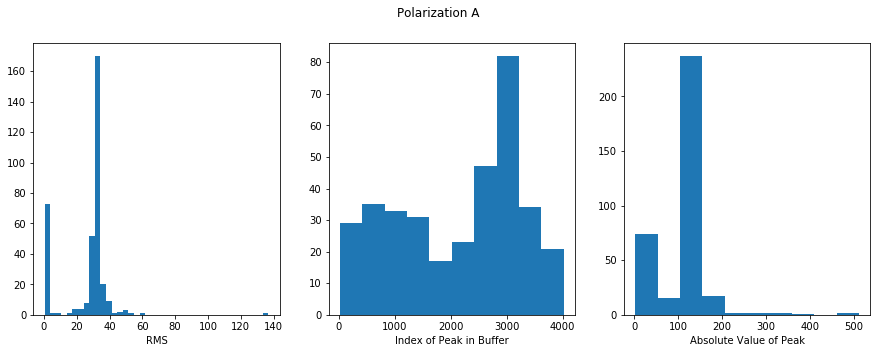

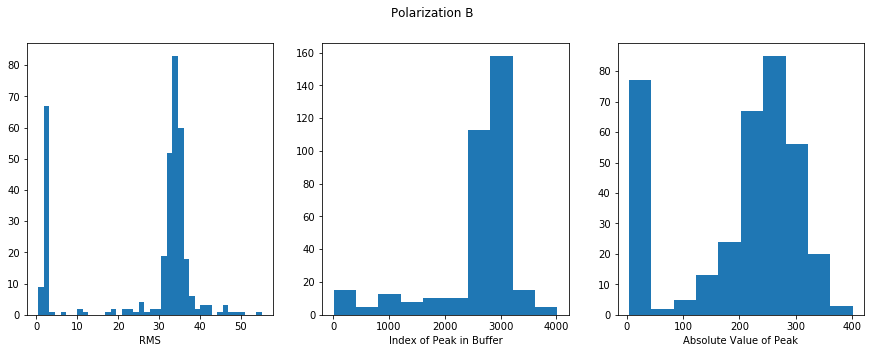

In [302]:
plt.figure(figsize=(15,5))
plt.suptitle('Polarization A')
plt.subplot(131)
plt.hist(rmsA,40)
plt.xlabel('RMS')
plt.subplot(132)
plt.hist(index_peak_A)
plt.xlabel('Index of Peak in Buffer')
plt.subplot(133)
plt.hist(peakA)
plt.xlabel('Absolute Value of Peak')

plt.show()

plt.figure(figsize=(15,5))
plt.suptitle('Polarization B')

plt.subplot(131)
plt.hist(rmsB,40)
plt.xlabel('RMS')
plt.subplot(132)
plt.hist(index_peak_B)
plt.xlabel('Index of Peak in Buffer')
plt.subplot(133)
plt.hist(peakB)
plt.xlabel('Absolute Value of Peak')
plt.show()


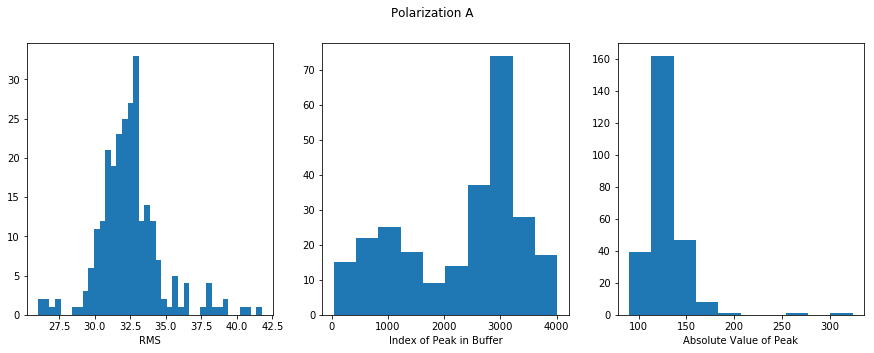

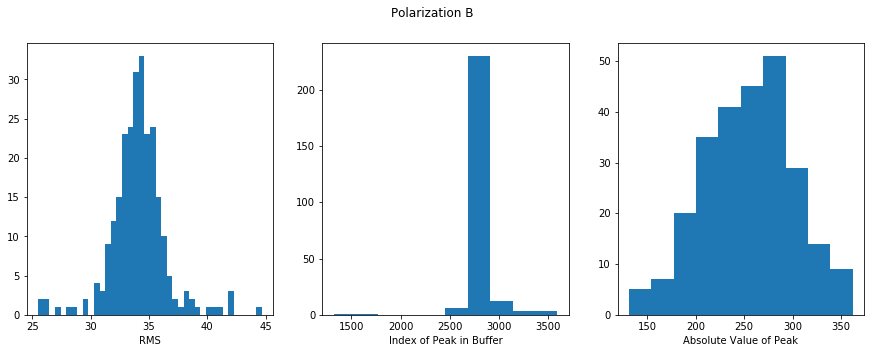

In [303]:


plt.figure(figsize=(15,5))
plt.suptitle('Polarization A')
plt.subplot(131)
plt.hist(rmsA[cutA],40)
plt.xlabel('RMS')
plt.subplot(132)
plt.hist(index_peak_A[cutA])
plt.xlabel('Index of Peak in Buffer')
plt.subplot(133)
plt.hist(peakA[cutA])
plt.xlabel('Absolute Value of Peak')

plt.show()

plt.figure(figsize=(15,5))
plt.suptitle('Polarization B')

plt.subplot(131)
plt.hist(rmsB[cutB],40)
plt.xlabel('RMS')
plt.subplot(132)
plt.hist(index_peak_B[cutB])
plt.xlabel('Index of Peak in Buffer')
plt.subplot(133)
plt.hist(peakB[cutB])
plt.xlabel('Absolute Value of Peak')
plt.show()


Text(0.5,0,'East-West position [m]')

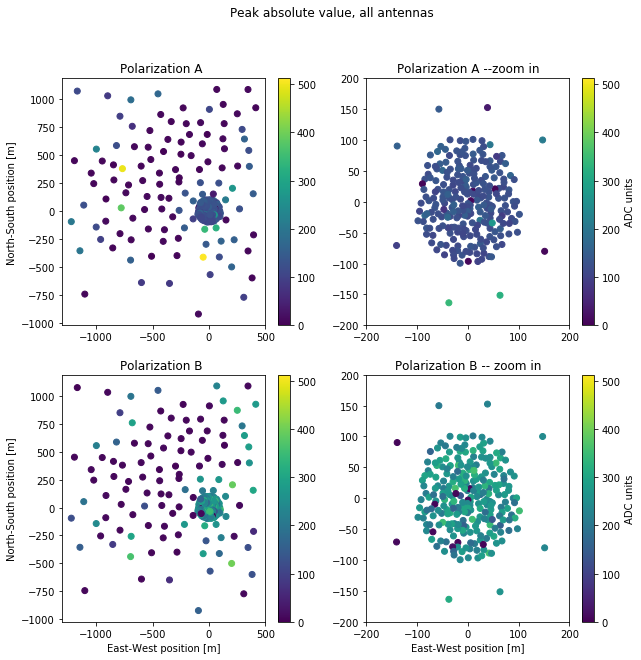

In [304]:
plt.figure(figsize=(10,10))
plt.suptitle('Peak absolute value, all antennas')
plt.subplot(221)
plt.title("Polarization A ")
plt.scatter(xcoords,ycoords,c=peakA)
plt.colorbar()
plt.clim(0,512)
plt.ylabel('North-South position [m]')

plt.subplot(222)
plt.title("Polarization A --zoom in")
plt.scatter(xcoords,ycoords,c=peakA)
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='ADC units')
plt.clim(0,512)

plt.subplot(223)
plt.title("Polarization B ")
plt.scatter(xcoords,ycoords,c=peakB)
plt.colorbar()
plt.clim(0,512)
plt.xlabel('East-West position [m]')
plt.ylabel('North-South position [m]')

plt.subplot(224)
plt.title("Polarization B -- zoom in")
plt.scatter(xcoords,ycoords,c=peakB)
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='ADC units')
plt.clim(0,512)
plt.xlabel('East-West position [m]')


Text(0.5,0,'East-West position [m]')

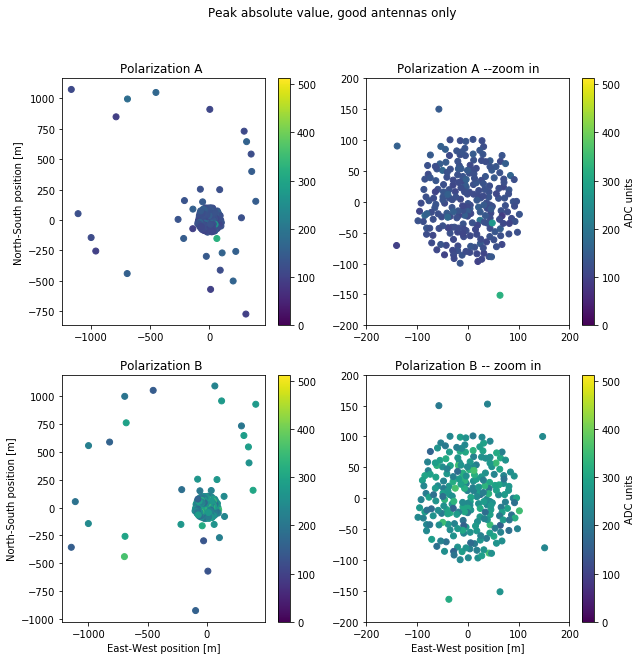

In [305]:
plt.figure(figsize=(10,10))
plt.suptitle('Peak absolute value, good antennas only')
plt.subplot(221)
plt.title("Polarization A ")
plt.scatter(xcoords[cutA],ycoords[cutA],c=peakA[cutA])
plt.colorbar()
plt.clim(0,512)
plt.ylabel('North-South position [m]')

plt.subplot(222)
plt.title("Polarization A --zoom in")
plt.scatter(xcoords[cutA],ycoords[cutA],c=peakA[cutA])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='ADC units')
plt.clim(0,512)

plt.subplot(223)
plt.title("Polarization B ")
plt.scatter(xcoords[cutB],ycoords[cutB],c=peakB[cutB])
plt.colorbar()
plt.clim(0,512)
plt.xlabel('East-West position [m]')
plt.ylabel('North-South position [m]')

plt.subplot(224)
plt.title("Polarization B -- zoom in")
plt.scatter(xcoords[cutB],ycoords[cutB],c=peakB[cutB])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='ADC units')
plt.clim(0,512)
plt.xlabel('East-West position [m]')

In [306]:
def plot_peak_to_rms_ratio(peak_to_rmsA,cutA,peak_to_rmsB,cutB,xcoords,ycoords,cmin,cmax):
    plt.figure(figsize=(10,10))
    plt.suptitle('Ratio of Peak absolute value to RMS, good antennas only')
    plt.subplot(221)
    plt.title("Polarization A ")
    plt.scatter(xcoords[cutA],ycoords[cutA],c=peak_to_rmsA[cutA])
    plt.colorbar()
    plt.clim(cmin,cmax)
    plt.ylabel('North-South position [m]')

    plt.subplot(222)
    plt.title("Polarization A --zoom in")
    plt.scatter(xcoords[cutA],ycoords[cutA],c=peak_to_rmsA[cutA])
    plt.xlim(-200,200)
    plt.ylim(-200,200)
    plt.colorbar(label='ADC units')
    plt.clim(cmin,cmax)

    plt.subplot(223)
    plt.title("Polarization B ")
    plt.scatter(xcoords[cutB],ycoords[cutB],c=peak_to_rmsB[cutB])
    plt.colorbar()
    plt.clim(cmin,cmax)
    plt.xlabel('East-West position [m]')
    plt.ylabel('North-South position [m]')

    plt.subplot(224)
    plt.title("Polarization B -- zoom in")
    plt.scatter(xcoords[cutB],ycoords[cutB],c=peak_to_rmsB[cutB])
    plt.xlim(-200,200)
    plt.ylim(-200,200)
    plt.colorbar(label='ADC units')
    plt.clim(cmin,cmax)
    plt.xlabel('East-West position [m]')
    return

2 226 0.008849557522123894


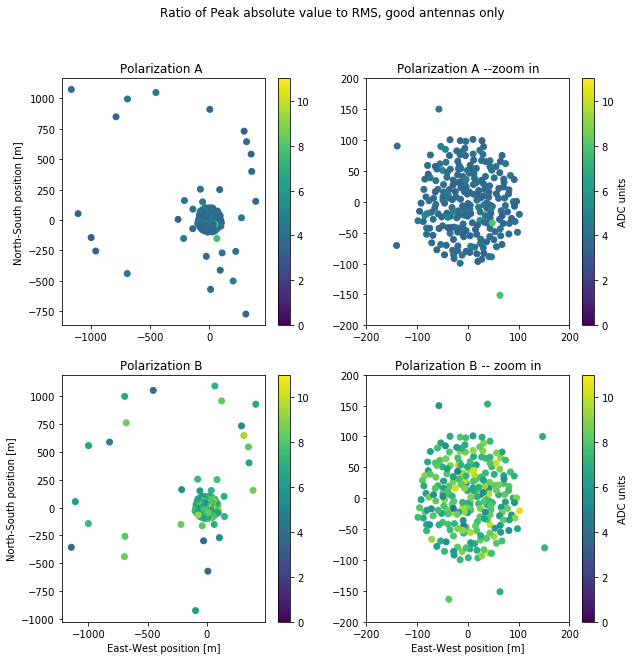

In [307]:
cmin=0
cmax=11
minsnr=6

peak_to_rmsA=peakA/rmsA
peak_to_rmsB=peakB/rmsB

plot_peak_to_rms_ratio(peak_to_rmsA,cutA,peak_to_rmsB,cutB,xcoords,ycoords,cmin,cmax)
strongAdetections=np.sum((peak_to_rmsA[cutA])>minsnr)
strongBdetections=np.sum((peak_to_rmsB[cutB])>minsnr)

print(strongAdetections,strongBdetections,strongAdetections/strongBdetections)


Text(0.5,0,'East-West position [m]')

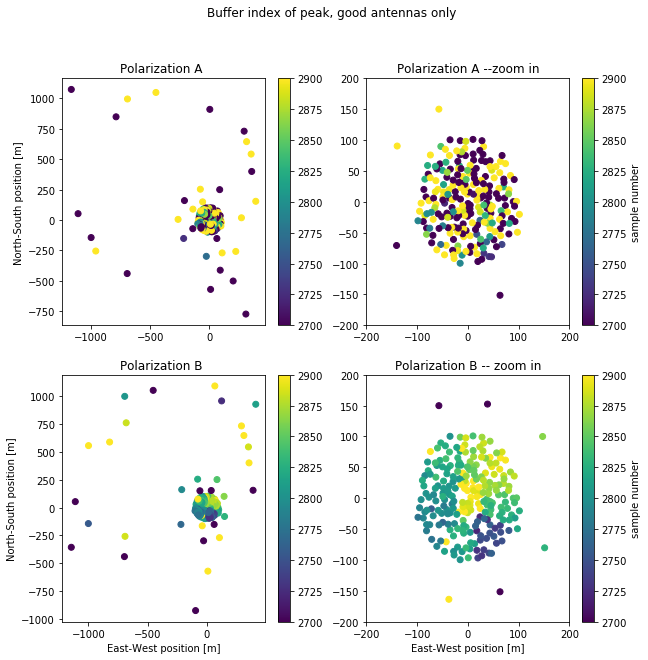

In [308]:
cmin=2700
cmax=2900

plt.figure(figsize=(10,10))
plt.suptitle('Buffer index of peak, good antennas only')
plt.subplot(221)
plt.title("Polarization A ")
plt.scatter(xcoords[cutA],ycoords[cutA],c=index_peak_A[cutA])
plt.colorbar()
plt.clim(cmin,cmax)
plt.ylabel('North-South position [m]')

plt.subplot(222)
plt.title("Polarization A --zoom in")
plt.scatter(xcoords[cutA],ycoords[cutA],c=index_peak_A[cutA])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='sample number')
plt.clim(cmin,cmax)

plt.subplot(223)
plt.title("Polarization B ")
plt.scatter(xcoords[cutB],ycoords[cutB],c=index_peak_B[cutB])
plt.colorbar()
plt.clim(cmin,cmax)
plt.xlabel('East-West position [m]')
plt.ylabel('North-South position [m]')

plt.subplot(224)
plt.title("Polarization B -- zoom in")
plt.scatter(xcoords[cutB],ycoords[cutB],c=index_peak_B[cutB])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='sample number')
plt.clim(cmin,cmax)
plt.xlabel('East-West position [m]')

Notice the timing offsets between different snap2 boards.  Next, I'll transform the buffer index into a relative time offset using the timestamp in each packet.

Text(0.5,0,'East-West position [m]')

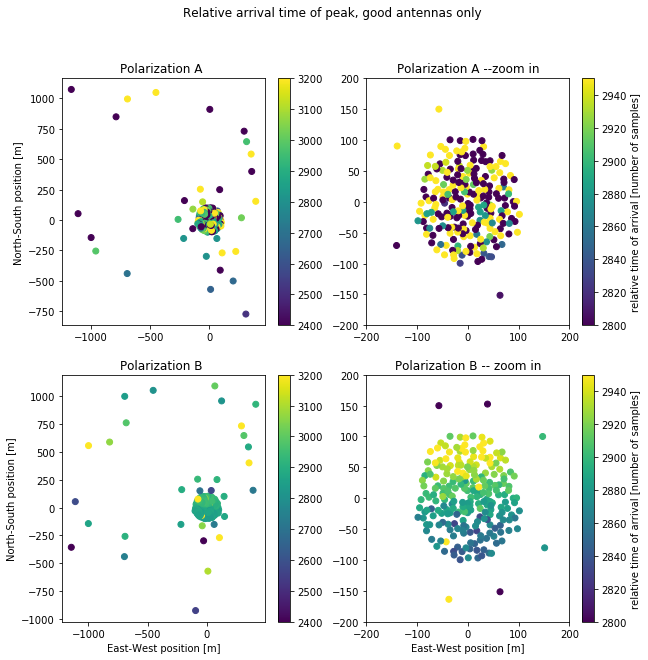

In [309]:
cmin_zoom=2800
cmax_zoom=2950
cmin=2400
cmax=3200
t_rel_A=index_peak_A + timestamps - min_time
t_rel_B=index_peak_B + timestamps - min_time

plt.figure(figsize=(10,10))
plt.suptitle('Relative arrival time of peak, good antennas only')
plt.subplot(221)
plt.title("Polarization A ")
plt.scatter(xcoords[cutA],ycoords[cutA],c=t_rel_A[cutA])
plt.colorbar()
plt.clim(cmin,cmax)
plt.ylabel('North-South position [m]')

plt.subplot(222)
plt.title("Polarization A --zoom in")
plt.scatter(xcoords[cutA],ycoords[cutA],c=t_rel_A[cutA])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='relative time of arrival [number of samples]')
plt.clim(cmin_zoom,cmax_zoom)

plt.subplot(223)
plt.title("Polarization B ")
plt.scatter(xcoords[cutB],ycoords[cutB],c=t_rel_B[cutB])
plt.colorbar()
plt.clim(cmin,cmax)
plt.xlabel('East-West position [m]')
plt.ylabel('North-South position [m]')

plt.subplot(224)
plt.title("Polarization B -- zoom in")
plt.scatter(xcoords[cutB],ycoords[cutB],c=t_rel_B[cutB])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='relative time of arrival [number of samples]')
plt.clim(cmin_zoom,cmax_zoom)
plt.xlabel('East-West position [m]')

Text(0.5,0,'East-West position [m]')

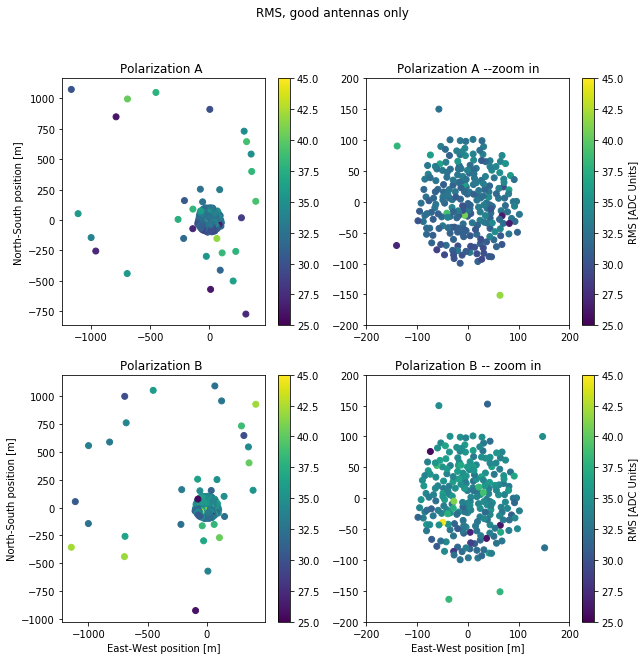

In [310]:
cmin=minimum_ok_rms
cmax=maximum_ok_rms

plt.figure(figsize=(10,10))
plt.suptitle('RMS, good antennas only')
plt.subplot(221)
plt.title("Polarization A ")
plt.scatter(xcoords[cutA],ycoords[cutA],c=rmsA[cutA])
plt.colorbar()
plt.clim(cmin,cmax)
plt.ylabel('North-South position [m]')

plt.subplot(222)
plt.title("Polarization A --zoom in")
plt.scatter(xcoords[cutA],ycoords[cutA],c=rmsA[cutA])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='RMS [ADC Units]')
plt.clim(cmin,cmax)

plt.subplot(223)
plt.title("Polarization B ")
plt.scatter(xcoords[cutB],ycoords[cutB],c=rmsB[cutB])
plt.colorbar()
plt.clim(cmin,cmax)
plt.xlabel('East-West position [m]')
plt.ylabel('North-South position [m]')

plt.subplot(224)
plt.title("Polarization B -- zoom in")
plt.scatter(xcoords[cutB],ycoords[cutB],c=rmsB[cutB])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='RMS [ADC Units]')
plt.clim(cmin,cmax)
plt.xlabel('East-West position [m]')

Text(0.5,0,'East-West position [m]')

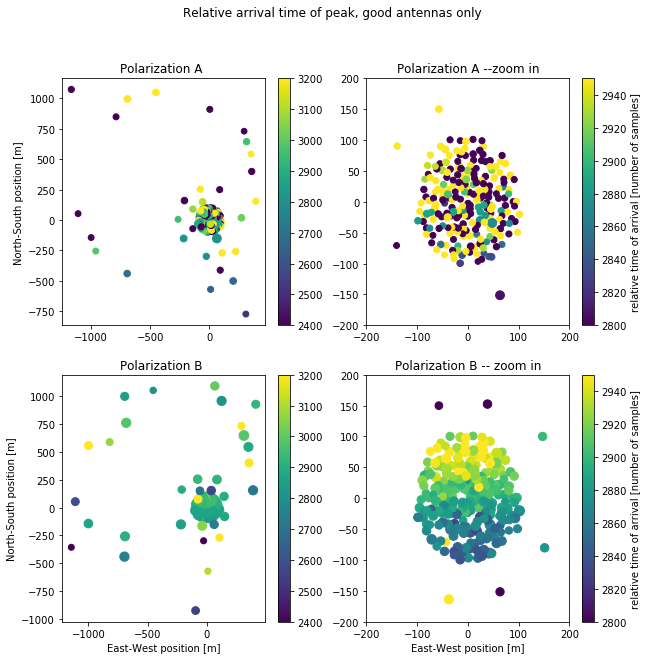

In [311]:
cmin_zoom=2800
cmax_zoom=2950
cmin=2400
cmax=3200
scale=10

t_rel_A=index_peak_A + timestamps - min_time
t_rel_B=index_peak_B + timestamps - min_time

plt.figure(figsize=(10,10))
plt.suptitle('Relative arrival time of peak, good antennas only')
plt.subplot(221)
plt.title("Polarization A ")
plt.scatter(xcoords[cutA],ycoords[cutA],c=t_rel_A[cutA],s=scale*(peakA/rmsA)[cutA])
plt.colorbar()
plt.clim(cmin,cmax)
plt.ylabel('North-South position [m]')

plt.subplot(222)
plt.title("Polarization A --zoom in")
plt.scatter(xcoords[cutA],ycoords[cutA],c=t_rel_A[cutA],s=scale*(peakA/rmsA)[cutA])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='relative time of arrival [number of samples]')
plt.clim(cmin_zoom,cmax_zoom)

plt.subplot(223)
plt.title("Polarization B ")
plt.scatter(xcoords[cutB],ycoords[cutB],c=t_rel_B[cutB],s=scale*(peakB/rmsB)[cutB])
plt.colorbar()
plt.clim(cmin,cmax)
plt.xlabel('East-West position [m]')
plt.ylabel('North-South position [m]')

plt.subplot(224)
plt.title("Polarization B -- zoom in")
plt.scatter(xcoords[cutB],ycoords[cutB],c=t_rel_B[cutB],s=scale*(peakB/rmsB)[cutB])
plt.xlim(-200,200)
plt.ylim(-200,200)
plt.colorbar(label='relative time of arrival [number of samples]')
plt.clim(cmin_zoom,cmax_zoom)
plt.xlabel('East-West position [m]')

In [1]:
def toa_plane(ant_coords,theta,phi):
    #This calculates the arrival times at each antenna of a plane wave moving across the array
    #The TOAs are returned in number of clock cycles relative to the arrival time at the zero,zero,zero coordinate
    #theta and phi in degrees, coordinates in meters
    #theta is the angle between the source direction and zenith. Theta=0 for a zenith source
    #phi is the azimuth angle of the source
    c=3e8
    sample_rate=1.97e8 #MHz
    phi_rad=(phi*math.pi/180)
    theta_rad=theta*math.pi/180
    x,y,z=ant_coords
    
    #calculate cartesian unit vector in the direction of the source
    yhat=math.sin(theta_rad)*math.cos(phi_rad)
    xhat=math.sin(theta_rad)*math.sin(phi_rad)
    zhat=math.cos(theta_rad)
    
    #project all the antenna coordinates into the source direction
    dot_product=((xhat*x)+(yhat*y)+(zhat*z))
    
    #convert distance to a time offset in number of clock cycles
    time_diff=(sample_rate/c)*dot_product  
    return time_diff

def grad_toa_plane(ant_coords,theta,phi):
    #This is the gradient of toa_plane w.r.t theta and phi
    c=3e8
    sample_rate=1.97e8 #MHz
    phi_rad=(phi*math.pi/180)
    theta_rad=theta*math.pi/180
    x,y,z=ant_coords

    dtdtheta=(math.pi/180)*(sample_rate/c)*((y*math.cos(theta_rad)*math.cos(phi_rad))+(x*math.cos(theta_rad)*math.cos(phi_rad))-(z*math.sin(theta_rad)))
    dtdphi=(math.pi/180)*(sample_rate/c)*((-y*math.sin(theta_rad)*math.sin(phi_rad)) +(x*math.sin(theta_rad)*math.cos(phi_rad)))
    return np.asarray([dtdtheta,dtdphi]).transpose()


def plot_fit(x,y,toa_data,best_model_toas,residual,czoom_min,czoom_max,title):
    plt.figure(figsize=(15,10))
    plt.suptitle(title)
    plt.subplot(231)
    plt.axes='equal'
    plt.scatter(x,y,c=toa_data)
    plt.colorbar()
    plt.title('Observed relative TOAs')

    plt.subplot(232)
    plt.axes='equal'
    plt.scatter(x,y,c=best_model_toas)
    plt.colorbar()
    plt.title('Best fit model toas')


    plt.subplot(233)
    plt.axes='equal'
    plt.scatter(x,y,c=residual)
    plt.colorbar()
    plt.title('Residual')


    plt.subplot(234)
    plt.axes='equal'
    plt.scatter(x,y,c=toa_data)
    plt.colorbar()
    plt.xlim(-200,200)
    plt.ylim(-200,200)
    plt.clim(czoom_min,czoom_max)
    plt.title('Observed relative TOAs')


    plt.subplot(235)
    plt.axes='equal'
    plt.scatter(x,y,c=best_model_toas)
    plt.colorbar()
    plt.xlim(-200,200)
    plt.ylim(-200,200)
    plt.clim(czoom_min,czoom_max)
    plt.title('Best fit model toas')


    plt.subplot(236)
    plt.axes='equal'
    plt.scatter(x,y,c=residual)
    plt.colorbar()
    plt.xlim(-200,200)
    plt.ylim(-200,200)
    plt.clim(czoom_min,czoom_max)
    plt.title('Residual')


[32.75690907 44.20451997] [[24.36348405  1.27953874]
 [ 1.27953874 55.51568359]]


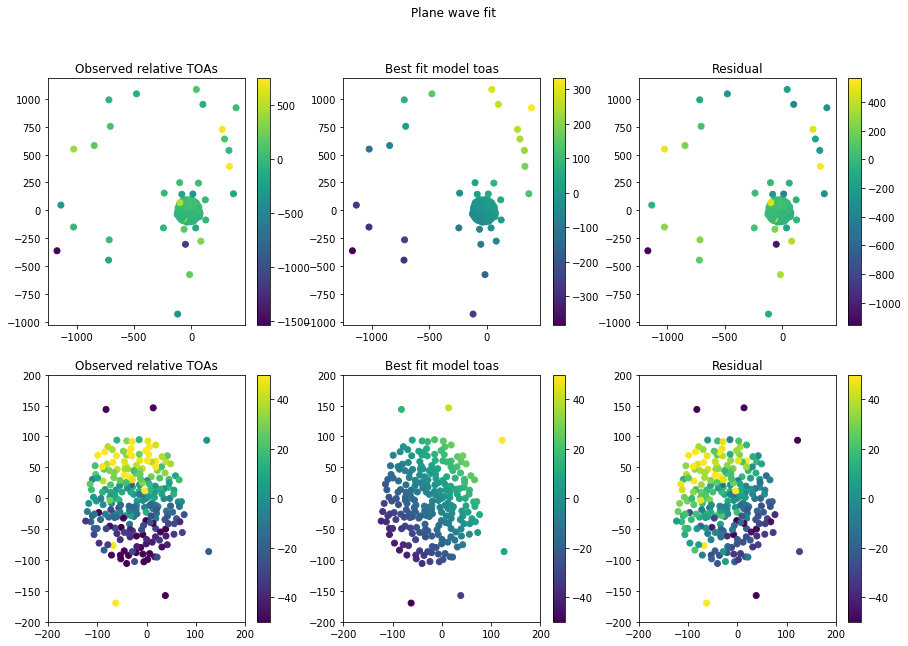

In [313]:
#I'm using the first antenna that passes the rms cuts as the reference antenna, and only using B polarization
x=xcoords[cutB]-xcoords[cutB][0]
y=ycoords[cutB]-ycoords[cutB][0]
z=zcoords[cutB]-zcoords[cutB][0]

t=t_rel_B[cutB]-t_rel_B[cutB][0]


ant_coords=np.zeros((3,len(x)))
ant_coords[0,:]=x
ant_coords[1,:]=y
ant_coords[2,:]=z

popt, pcov = curve_fit(toa_plane, ant_coords,t,bounds=([0,0],[90,360]),jac=grad_toa_plane)

print(popt,pcov)
theta_best=popt[0]
phi_best=popt[1]

#plot the results
best_model_toas=toa_plane(ant_coords,theta_best,phi_best)
residual=t-best_model_toas

czoom_min=-50
czoom_max=50
title='Plane wave fit'
plot_fit(x,y,t,best_model_toas,residual,czoom_min,czoom_max,title)

[  1.41212285 279.97333269] [[  658.65018223 -5314.77506188]
 [-5314.77506188 60969.38816687]]


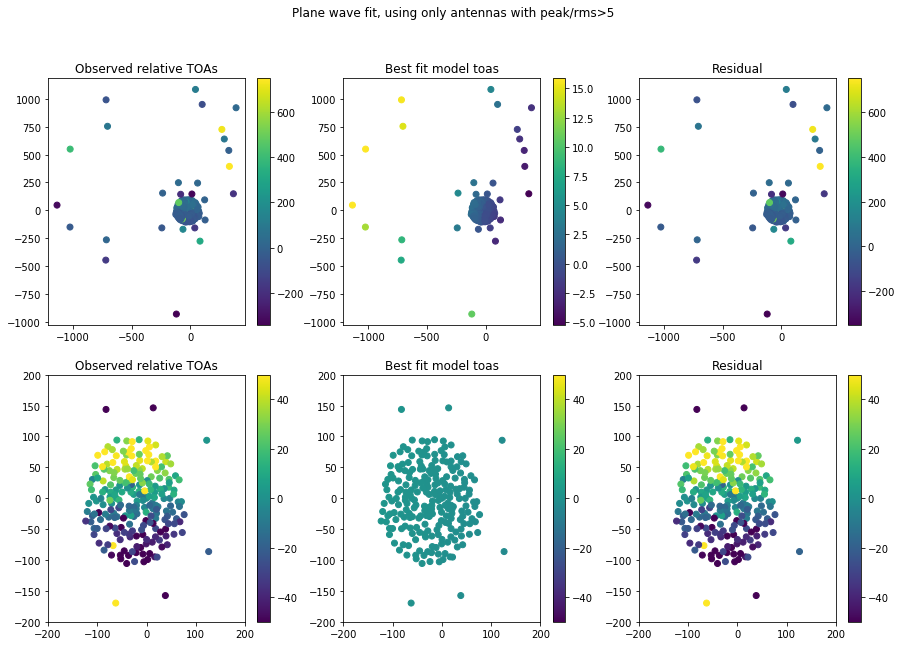

In [314]:
#Now I'm also making a cut on snr
#I'm still using the first antenna that passes the cuts as the reference antenna, and only using B polarization

minsnr=5
cut_snrB=np.logical_and(((peakB/rmsB) >minsnr), (cutB))


x=xcoords[cut_snrB]-xcoords[cut_snrB][0]
y=ycoords[cut_snrB]-ycoords[cut_snrB][0]
z=zcoords[cut_snrB]-zcoords[cut_snrB][0]

t=t_rel_B[cut_snrB]-t_rel_B[cut_snrB][0]


ant_coords=np.zeros((3,len(x)))
ant_coords[0,:]=x
ant_coords[1,:]=y
ant_coords[2,:]=z

popt, pcov = curve_fit(toa_plane, ant_coords,t,bounds=([0,0],[90,360]),jac=grad_toa_plane)

print(popt,pcov)
theta_best=popt[0]
phi_best=popt[1]

#plot the results
best_model_toas=toa_plane(ant_coords,theta_best,phi_best)
residual=t-best_model_toas

czoom_min=-50
czoom_max=50
title='Plane wave fit, using only antennas with peak/rms>'+str(minsnr)
plot_fit(x,y,t,best_model_toas,residual,czoom_min,czoom_max,title)

[ 30.22414207 337.55676521] [[  47.91080291 -103.88804744]
 [-103.88804744  271.1109104 ]]


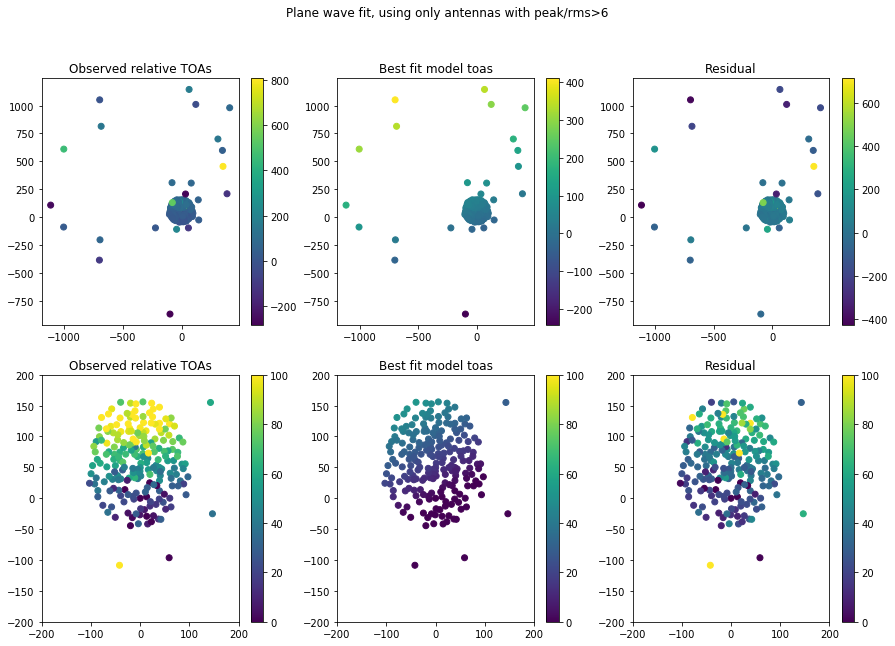

In [315]:
#Now I'm also making a cut on snr
#I'm still using the first antenna that passes the cuts as the reference antenna, and only using B polarization

minsnr=6
cut_snrB=np.logical_and(((peakB/rmsB) >minsnr), (cutB))


x=xcoords[cut_snrB]-xcoords[cut_snrB][0]
y=ycoords[cut_snrB]-ycoords[cut_snrB][0]
z=zcoords[cut_snrB]-zcoords[cut_snrB][0]

t=t_rel_B[cut_snrB]-t_rel_B[cut_snrB][0]


ant_coords=np.zeros((3,len(x)))
ant_coords[0,:]=x
ant_coords[1,:]=y
ant_coords[2,:]=z

popt, pcov = curve_fit(toa_plane, ant_coords,t,bounds=([0,0],[90,360]),jac=grad_toa_plane)

print(popt,pcov)
theta_best=popt[0]
phi_best=popt[1]

#plot the results
best_model_toas=toa_plane(ant_coords,theta_best,phi_best)
residual=t-best_model_toas

czoom_min=0
czoom_max=100
title='Plane wave fit, using only antennas with peak/rms>'+str(minsnr)
plot_fit(x,y,t,best_model_toas,residual,czoom_min,czoom_max,title)

Next, make a cut to only use the core.

[ 89.98234866 356.29740274] [[ 1.93926356e+06 -8.64920579e+03]
 [-8.64920579e+03  8.79811448e+01]]


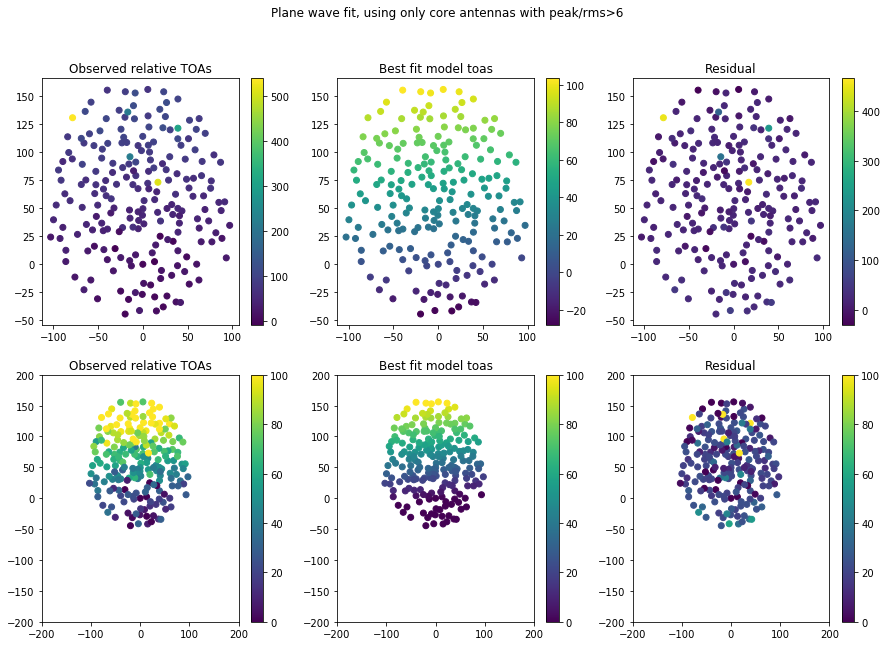

In [316]:
#Now I'm also making a cut on snr
#I'm still using the first antenna that passes the cuts as the reference antenna, and only using B polarization

minsnr=6
cut_snrB=np.logical_and(((peakB/rmsB) >minsnr), (cutB))

cut_rms_snrB_core=np.logical_and(cut_snrB, (xcoords**2)+(ycoords**2)<(150**2))


x=xcoords[cut_rms_snrB_core]-xcoords[cut_rms_snrB_core][0]
y=ycoords[cut_rms_snrB_core]-ycoords[cut_rms_snrB_core][0]
z=zcoords[cut_rms_snrB_core]-zcoords[cut_rms_snrB_core][0]

t=t_rel_B[cut_rms_snrB_core]-t_rel_B[cut_rms_snrB_core][0]


ant_coords=np.zeros((3,len(x)))
ant_coords[0,:]=x
ant_coords[1,:]=y
ant_coords[2,:]=z

popt, pcov = curve_fit(toa_plane, ant_coords,t,bounds=([0,0],[90,360]),jac=grad_toa_plane)

print(popt,pcov)
theta_best=popt[0]
phi_best=popt[1]

#plot the results
best_model_toas=toa_plane(ant_coords,theta_best,phi_best)
residual=t-best_model_toas

czoom_min=0
czoom_max=100
title='Plane wave fit, using only core antennas with peak/rms>'+str(minsnr)
plot_fit(x,y,t,best_model_toas,residual,czoom_min,czoom_max,title)

Can I pick a better fit by eye?

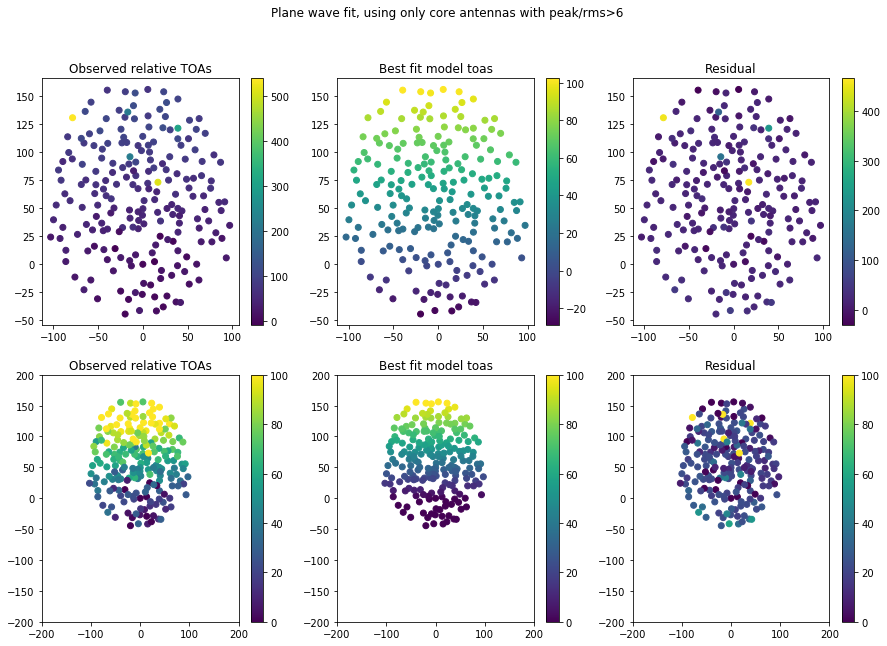

In [317]:
#plot a guess
best_model_toas=toa_plane(ant_coords,90,0)
residual=t-best_model_toas

czoom_min=0
czoom_max=100
title='Plane wave fit, using only core antennas with peak/rms>'+str(minsnr)
plot_fit(x,y,t,best_model_toas,residual,czoom_min,czoom_max,title)

In [318]:
plot_select_antennas(events[1],antennas)

TypeError: plot_select_antennas() missing 1 required positional argument: 'showpeak'

### Summary

In [14]:
#load data
fname = '/data1/cosmic-ray-data/2023May3/overnight1683180610.6110308.dat'
records = parsefile(fname, end_ind = 704*10)
#make a list of events
events=distinguishevents(records,200)
complete_events_count=0
incomplete_events_count=0
total=len(events)
for e in events:
    if len(e)==704:
        complete_events_count+=1
    else:
        incomplete_events_count+=1
print("Out of ",total," events, there are ",complete_events_count," have exactly 704 records assigned and ", incomplete_events_count, ' events have the wrong number of records.')


Out of  10  events, there are  10  have exactly 704 records assigned and  0  events have the wrong number of records.


0 97 0.0
Not enough polarization A detections to fit
Polarization B direction best theta, phi  [ 48.85073657 339.63000887]
Covariance matrix [[ 714.05877038 -662.31865578]
 [-662.31865578 1094.32622861]]
138 3 46.0
Polarization A direction best theta, phi  [ 90.         356.22451683]
Covariance matrix [[ 3.62266028e+05 -1.39539996e+03]
 [-1.39539996e+03  1.54684039e+01]]
Not enough polarization B detections to fit
2 95 0.021052631578947368
Not enough polarization A detections to fit
Polarization B direction best theta, phi  [ 90.         319.21697554]
Covariance matrix [[ 6.31735836e+06 -1.96989528e+03]
 [-1.96989528e+03  2.78803392e+02]]
157 7 22.428571428571427
Polarization A direction best theta, phi  [ 90. 360.]
Covariance matrix [[ 2.10095362e+05 -8.17198770e+02]
 [-8.17198770e+02  8.38122684e+00]]
Not enough polarization B detections to fit
2 114 0.017543859649122806
Not enough polarization A detections to fit
Polarization B direction best theta, phi  [ 50.24829914 343.56703224]


/home/ubuntu/anaconda3/envs/deployment/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


156 4 39.0
Polarization A direction best theta, phi  [ 90. 360.]
Covariance matrix [[ 2.61583150e+05 -1.41275459e+03]
 [-1.41275459e+03  1.26387226e+01]]
Not enough polarization B detections to fit


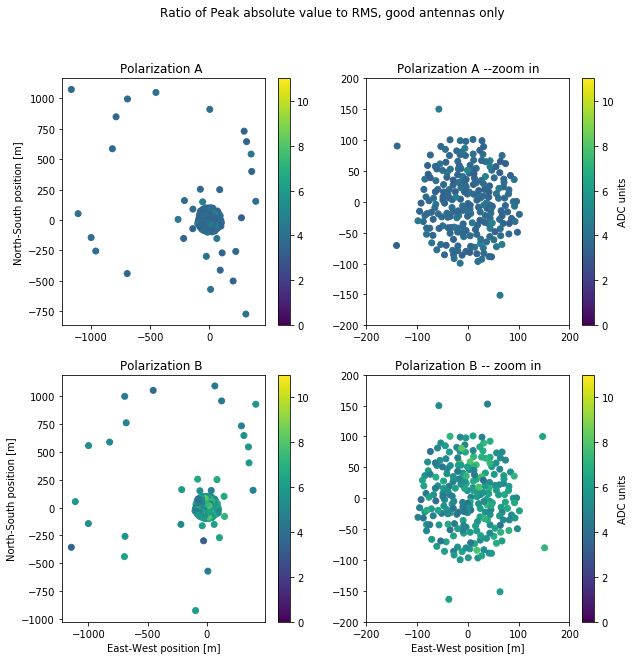

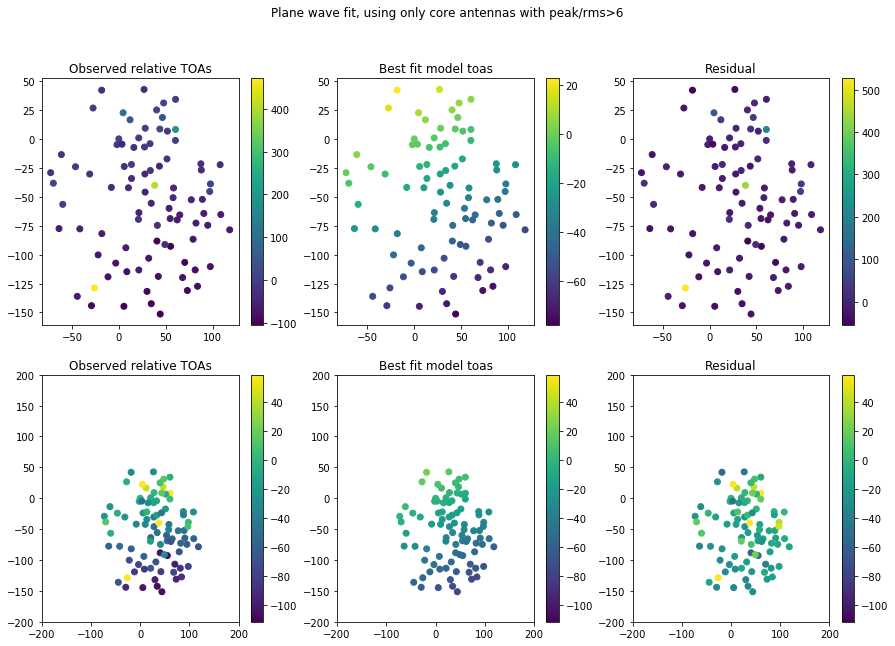

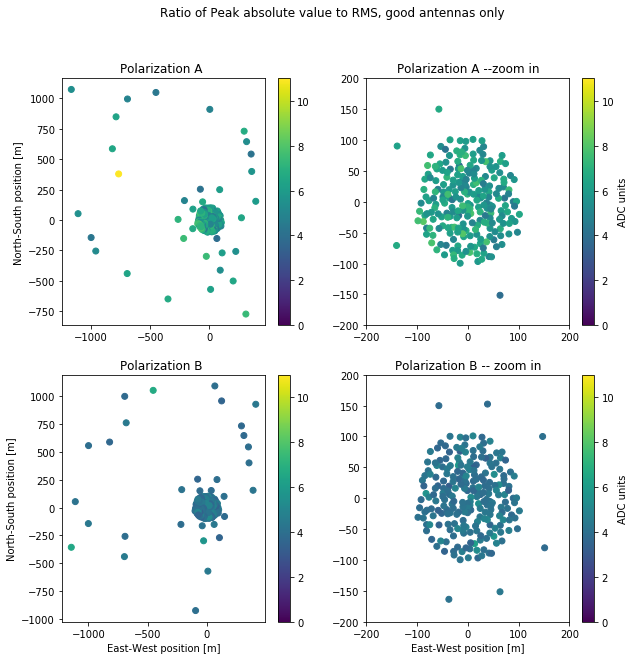

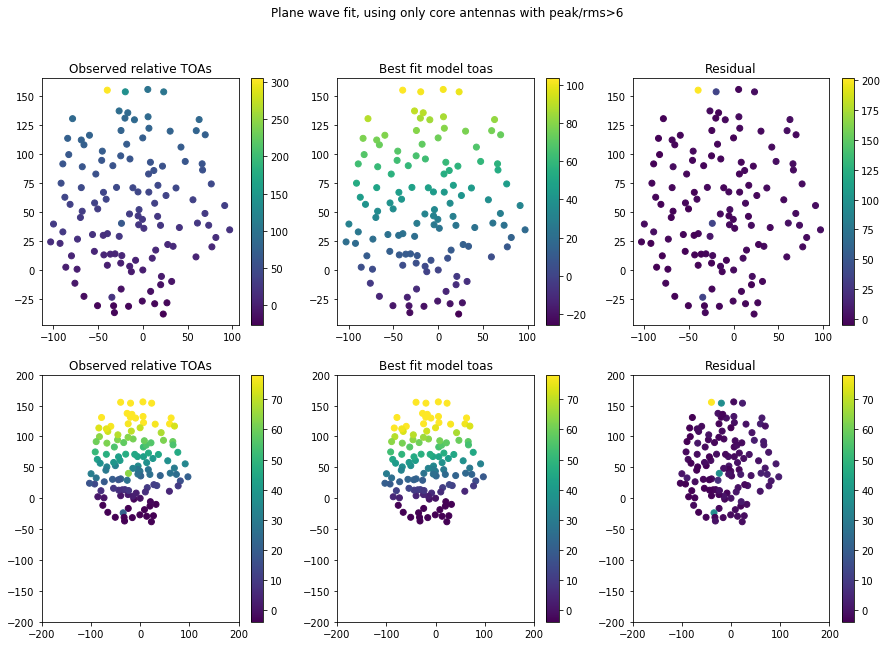

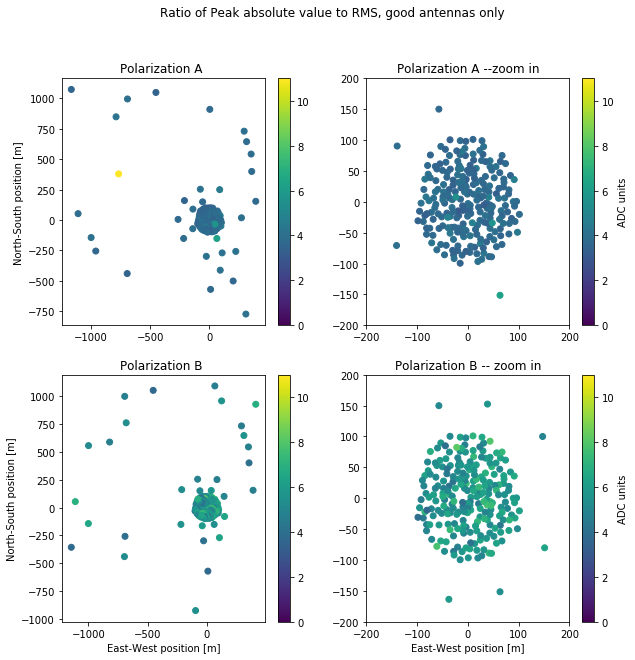

...

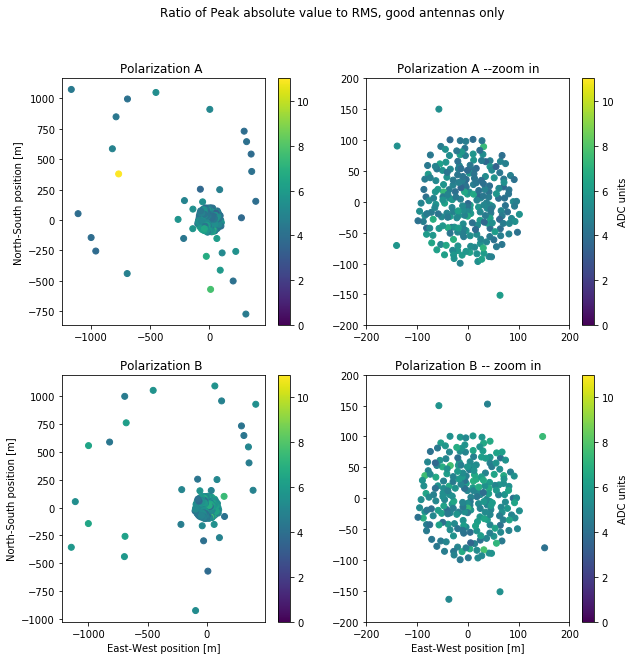

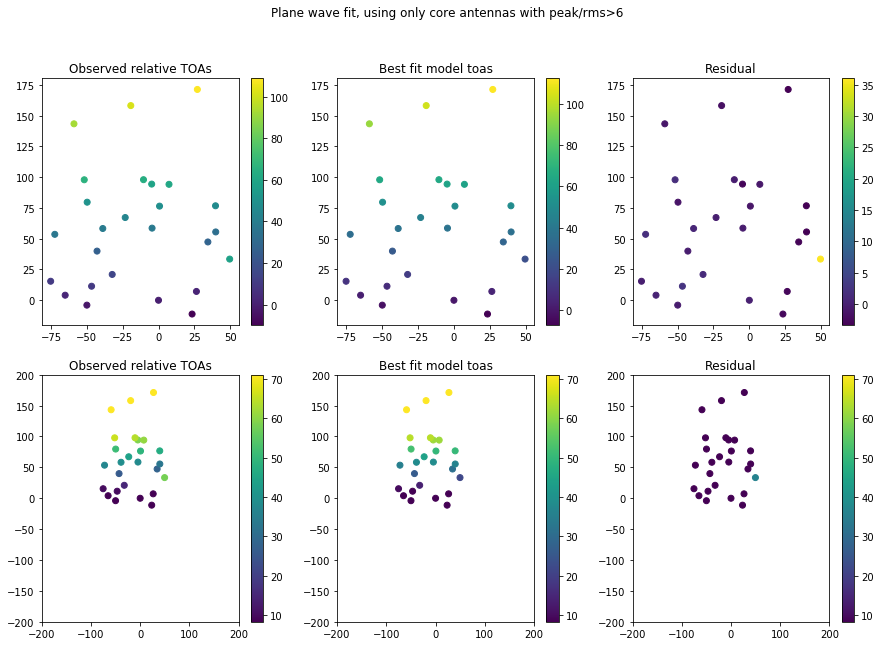

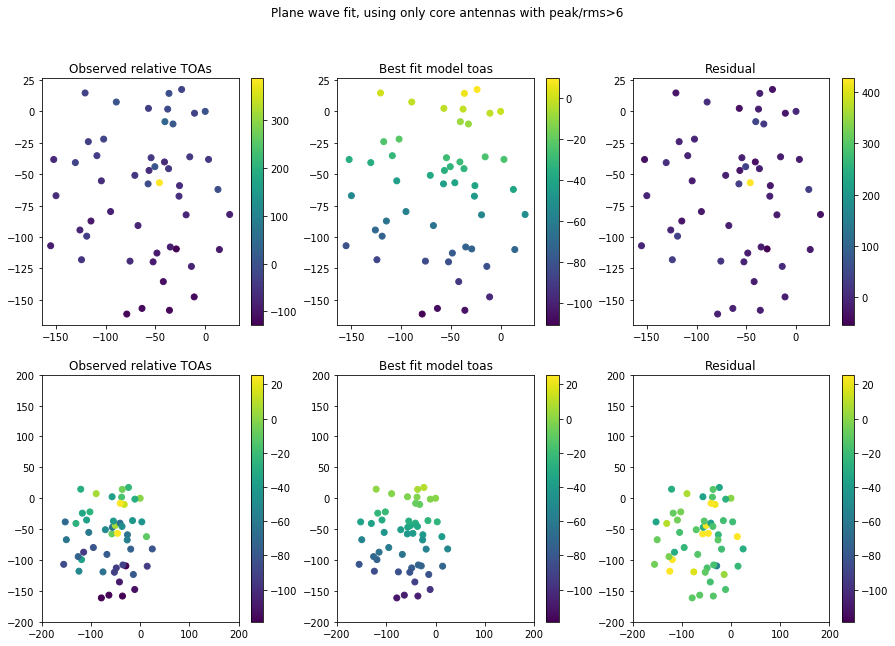

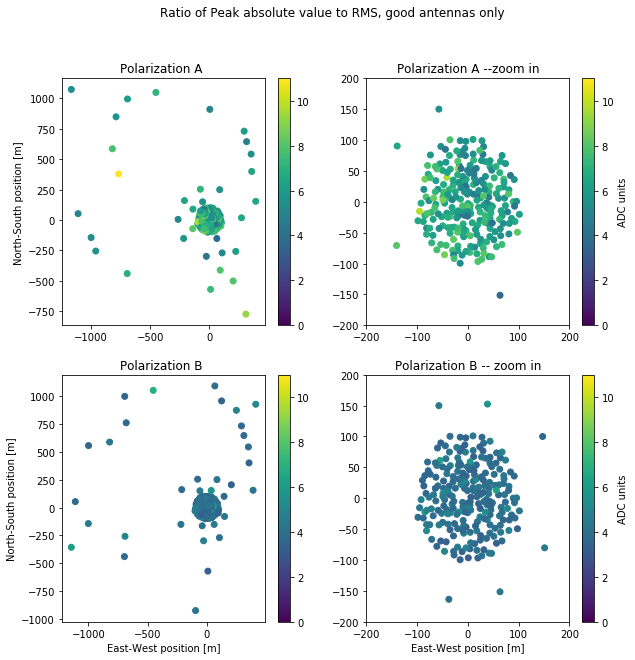

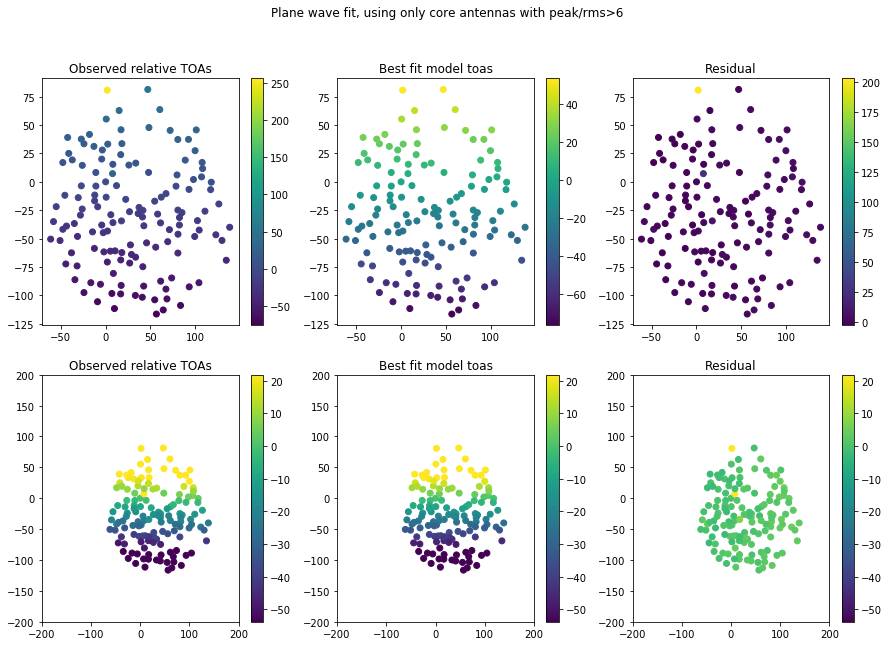

In [14]:

for event_indices in events:  #later do for all
    event=[records[i] for i in event_indices]
    mergedrecords=mergepolarizations(event)

    rmsA=np.asarray([record['rmsA'] for record in mergedrecords])
    peakA=np.asarray([record['peakA'] for record in mergedrecords])
    index_peak_A=np.asarray([record['index_peak_A'] for record in mergedrecords])

    rmsB=np.asarray([record['rmsB'] for record in mergedrecords])
    peakB=np.asarray([record['peakB'] for record in mergedrecords])
    index_peak_B=np.asarray([record['index_peak_B'] for record in mergedrecords])
    peak_to_rmsA=peakA/rmsA
    peak_to_rmsB=peakB/rmsB

    xcoords=np.asarray([record['x'] for record in mergedrecords])
    ycoords=np.asarray([record['y'] for record in mergedrecords])
    zcoords=np.asarray([record['z'] for record in mergedrecords])
    timestamps=np.asarray([record['timestamp'] for record in mergedrecords])
    min_time=np.min(timestamps)

    t_rel_A=index_peak_A + timestamps - min_time
    t_rel_B=index_peak_B + timestamps - min_time
    
    #make antenna cut based on rms
    maximum_ok_rms=45
    minimum_ok_rms=25
    cutA = np.logical_and(rmsA >minimum_ok_rms, rmsA <maximum_ok_rms)
    cutB = np.logical_and(rmsB >minimum_ok_rms, rmsB <maximum_ok_rms)
    
    cmin=0
    cmax=11
    minsnr=6
    minstrongdetections=20
    plot_peak_to_rms_ratio(peak_to_rmsA,cutA,peak_to_rmsB,cutB,xcoords,ycoords,cmin,cmax)
    strongAdetections=np.sum((peak_to_rmsA[cutA])>minsnr)
    strongBdetections=np.sum((peak_to_rmsB[cutB])>minsnr)
    print(strongAdetections,strongBdetections,strongAdetections/strongBdetections)
    
    #make whole array toa plot too?
    
    #fit direction
    if strongAdetections>minstrongdetections:
        try:
            #direction fit polarization A
            #Make antenna-based cuts on rms, peak-to-rms ratio, and only use core
            #I'm still using the first antenna that passes the cuts as the reference antenna
            cut_snrA=np.logical_and(((peakA/rmsA) >minsnr), (cutA))
            cut_rms_snrA_core=np.logical_and(cut_snrA, (xcoords**2)+(ycoords**2)<(150**2))

            x=xcoords[cut_rms_snrA_core]-xcoords[cut_rms_snrA_core][0]
            y=ycoords[cut_rms_snrA_core]-ycoords[cut_rms_snrA_core][0]
            z=zcoords[cut_rms_snrA_core]-zcoords[cut_rms_snrA_core][0]

            t=t_rel_A[cut_rms_snrA_core]-t_rel_A[cut_rms_snrA_core][0]

            ant_coords=np.zeros((3,len(x)))
            ant_coords[0,:]=x
            ant_coords[1,:]=y
            ant_coords[2,:]=z

            popt, pcov = curve_fit(toa_plane, ant_coords,t,bounds=([0,0],[90,360]),jac=grad_toa_plane)

            print("Polarization A direction best theta, phi ",popt)
            print("Covariance matrix",pcov)
            theta_best=popt[0]
            phi_best=popt[1]

            #plot the results
            best_model_toas=toa_plane(ant_coords,theta_best,phi_best)
            residual=t-best_model_toas
            czoom_min=np.mean(t)-np.std(t)
            czoom_max=np.mean(t)+np.std(t)
            title='Plane wave fit, using only core antennas with peak/rms>'+str(minsnr)
            plot_fit(x,y,t,best_model_toas,residual,czoom_min,czoom_max,title)
        except RuntimeError:
            print("Fit failed with runtime error.")
    else:
        print("Not enough polarization A detections to fit")
    
    if strongBdetections>minstrongdetections:
        #direction fit polarization B
        #Make antenna-based cuts on rms, peak-to-rms ratio, and only use core
        #I'm still using the first antenna that passes the cuts as the reference antenna
        try:
            cut_snrB=np.logical_and(((peakB/rmsB) >minsnr), (cutB))
            cut_rms_snrB_core=np.logical_and(cut_snrB, (xcoords**2)+(ycoords**2)<(150**2))

            x=xcoords[cut_rms_snrB_core]-xcoords[cut_rms_snrB_core][0]
            y=ycoords[cut_rms_snrB_core]-ycoords[cut_rms_snrB_core][0]
            z=zcoords[cut_rms_snrB_core]-zcoords[cut_rms_snrB_core][0]

            t=t_rel_B[cut_rms_snrB_core]-t_rel_B[cut_rms_snrB_core][0]

            ant_coords=np.zeros((3,len(x)))
            ant_coords[0,:]=x
            ant_coords[1,:]=y
            ant_coords[2,:]=z

            popt, pcov = curve_fit(toa_plane, ant_coords,t,bounds=([0,0],[90,360]),jac=grad_toa_plane)

            print("Polarization B direction best theta, phi ",popt)
            print("Covariance matrix",pcov)
            theta_best=popt[0]
            phi_best=popt[1]

            #plot the results
            best_model_toas=toa_plane(ant_coords,theta_best,phi_best)
            residual=t-best_model_toas
            czoom_min=np.mean(t)-np.std(t)
            czoom_max=np.mean(t)+np.std(t)
            title='Plane wave fit, using only core antennas with peak/rms>'+str(minsnr)
            plot_fit(x,y,t,best_model_toas,residual,czoom_min,czoom_max,title)
        except RuntimeError:
            print("Fit failed with RuntimeError")
    
    else:
        print("Not enough polarization B detections to fit")

## Show all timeseries

In [180]:
def plot_all_timeseries(event,showpeak):
    for b in range(11):
        singleboard=[record for record in event if record['board_id']==b+1]
        fig=plt.figure(figsize=(20,15))
        plt.suptitle("Board "+str(b+1)+" timestamp "+str(singleboard[0]['timestamp']))
        for i in range(64):
            ax=fig.add_subplot(8,8,1+i)
            if i<len(singleboard):
                record=singleboard[i]
                antenna=packet_ant_id_2_snap_input(record['antenna_id']) #Get the snap2 input number
                antname=mapping.snap2_to_antpol(b+1,antenna) #TODO zero index the boards or 1-index??

                timeseries=record['data']
                plt.plot(timeseries)
                ax.text(.5,.5,antname,horizontalalignment='center',transform=ax.transAxes)
                if showpeak:
                    peakindex=np.argmax(np.abs(timeseries))
                    plt.plot([peakindex,peakindex],[-1*np.abs(timeseries[peakindex]),np.abs(timeseries[peakindex])])
                
            if i > 55:
                plt.xlabel('time sample')
            if i%8==0:
                plt.ylabel('voltage [ADC units]')
    return



def plot_select_antennas(event,antennas,showpeak):
    #Event is a list of records (single-packet dictionaries) belonging to the same event
    #antennas is a list where each element in the list is a tuple of format (s,a) where s is the index of the snap board and a is the index of the antenna to plot
    #If a requested antenna to plot is not in the list (which happens if that packet has been lost), the missing antenna is skipped
    #The requested antennas are plotted in the order they appear in event, not in the order of the input list
    for record in event:
        s=record['board_id']
        a=record['antenna_id']
        antname=mapping.snap2_to_antpol(s,a)
        if (s,a) in antennas:
            timeseries=record['data']
            plt.figure(figsize=(20,5))
            plt.suptitle(antname + ' snap '+ str(s) + ' antenna ' + str(a))
            
            plt.subplot(131)
            plt.plot(timeseries)
            plt.xlabel('time sample')
            plt.ylabel('voltage [ADC units]')
            if showpeak:
                peakindex=np.argmax(np.abs(timeseries))
                #plt.plot([peakindex,peakindex],[-1*np.abs(timeseries[peakindex]),np.abs(timeseries[peakindex])])
                plt.plot([peakindex,peakindex],[0,timeseries[peakindex]])

            plt.subplot(132)
            plt.hist(timeseries)
            plt.xlabel('Voltage [ADC units]')
            plt.ylabel('Counts')

            plt.subplot(133)
            plt.xlabel('frequency channel')
            plt.ylabel('power')
            spec=np.fft.rfft(timeseries)
            plt.plot(np.log(np.square(np.abs(spec))))     
    return



/home/ubuntu/anaconda3/envs/deployment/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


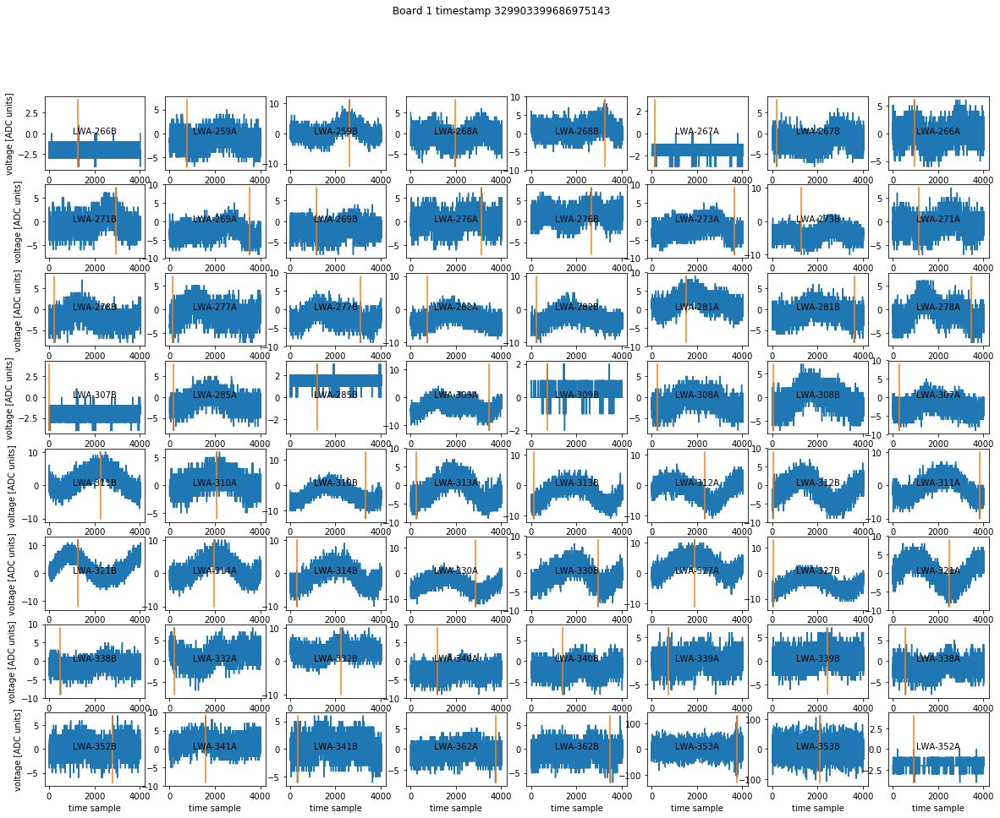

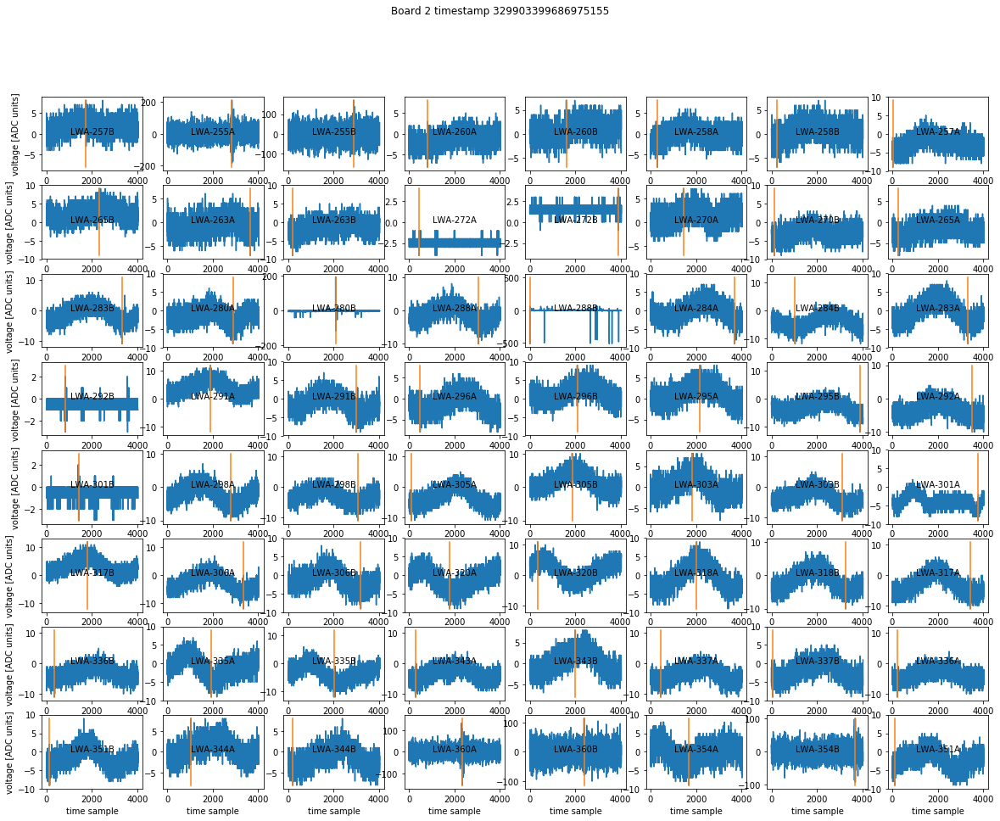

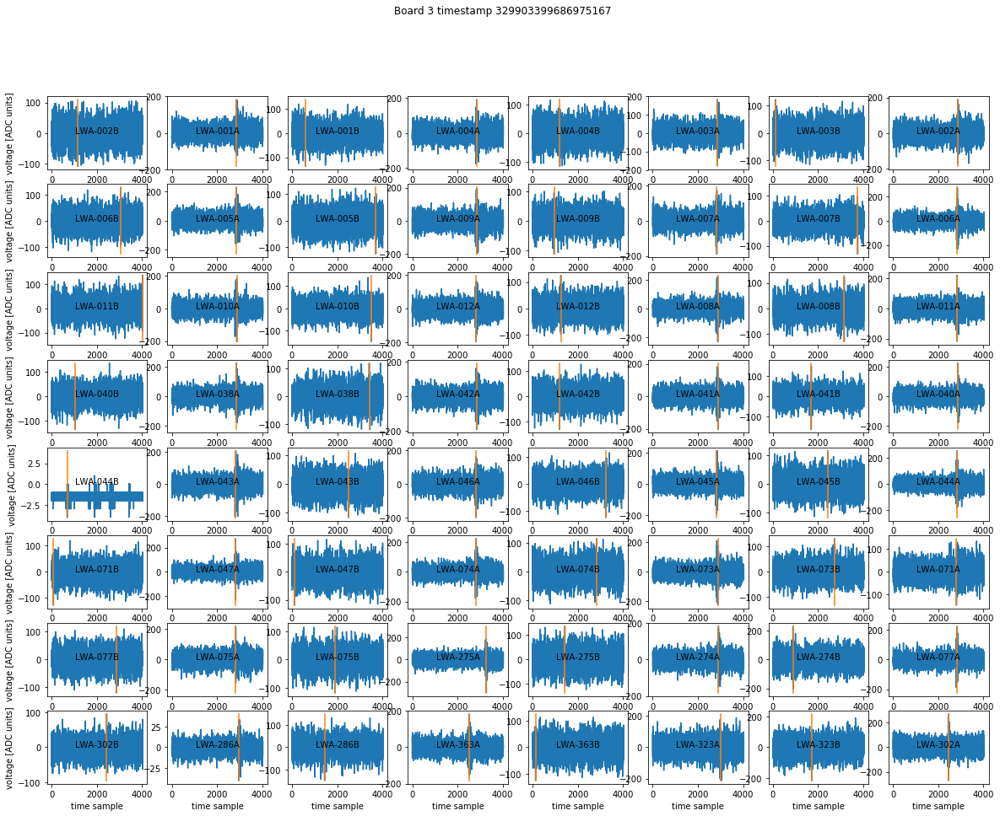

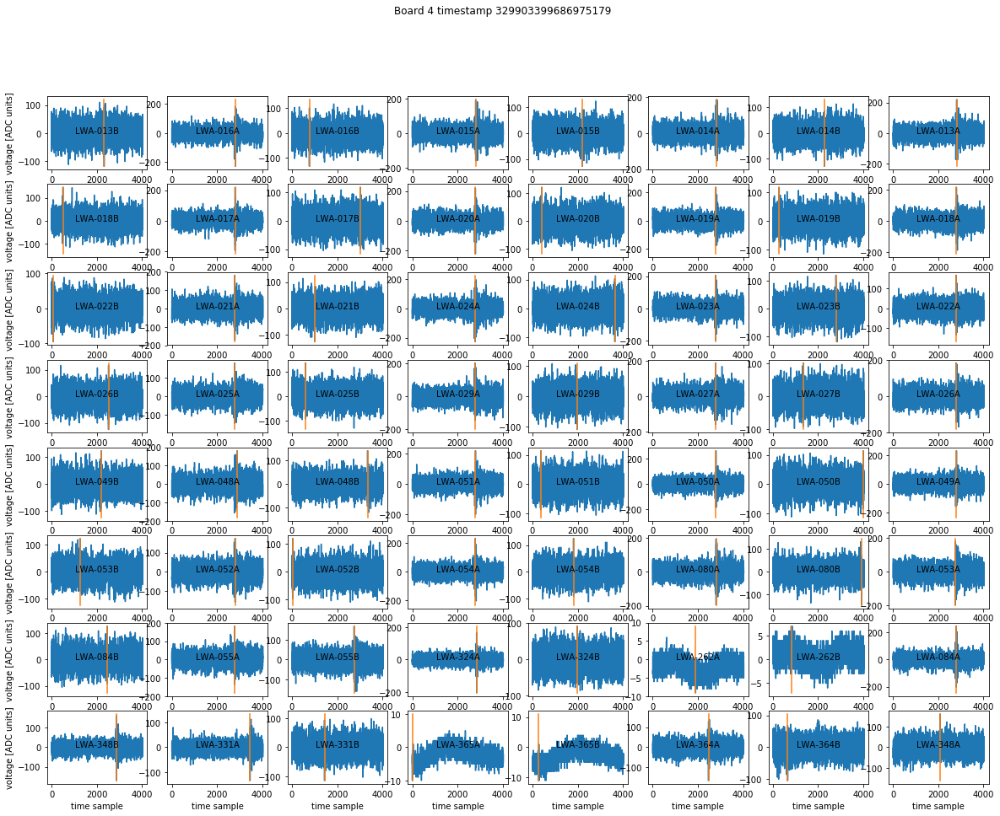

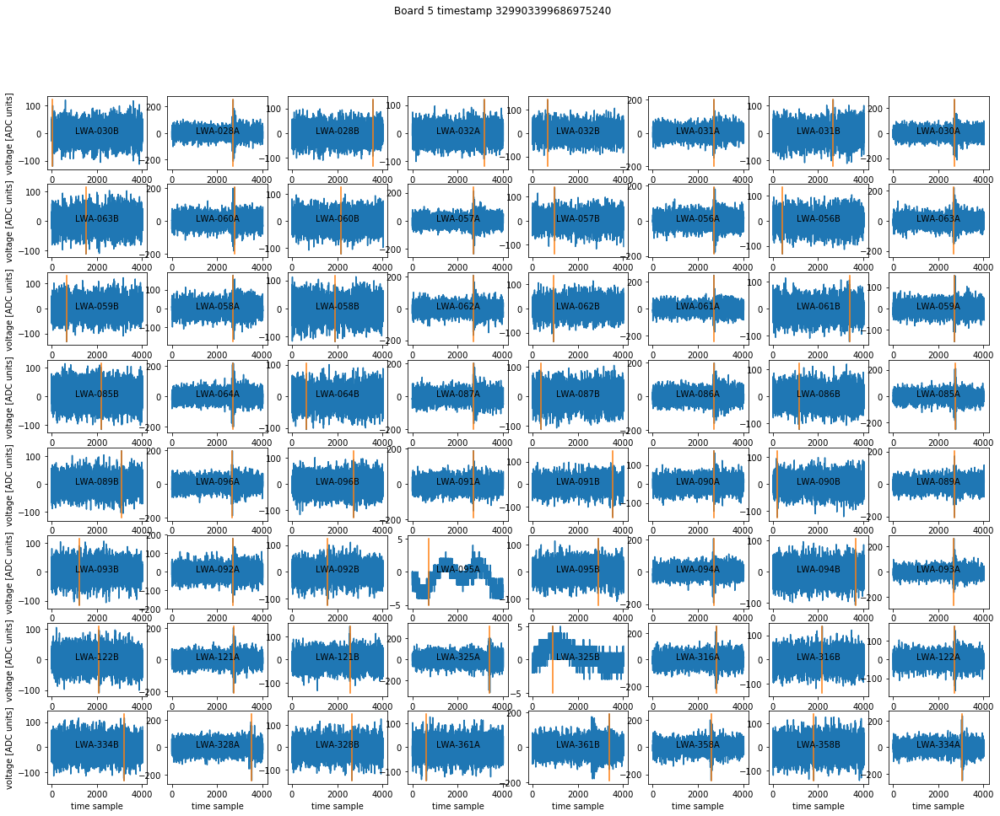

...

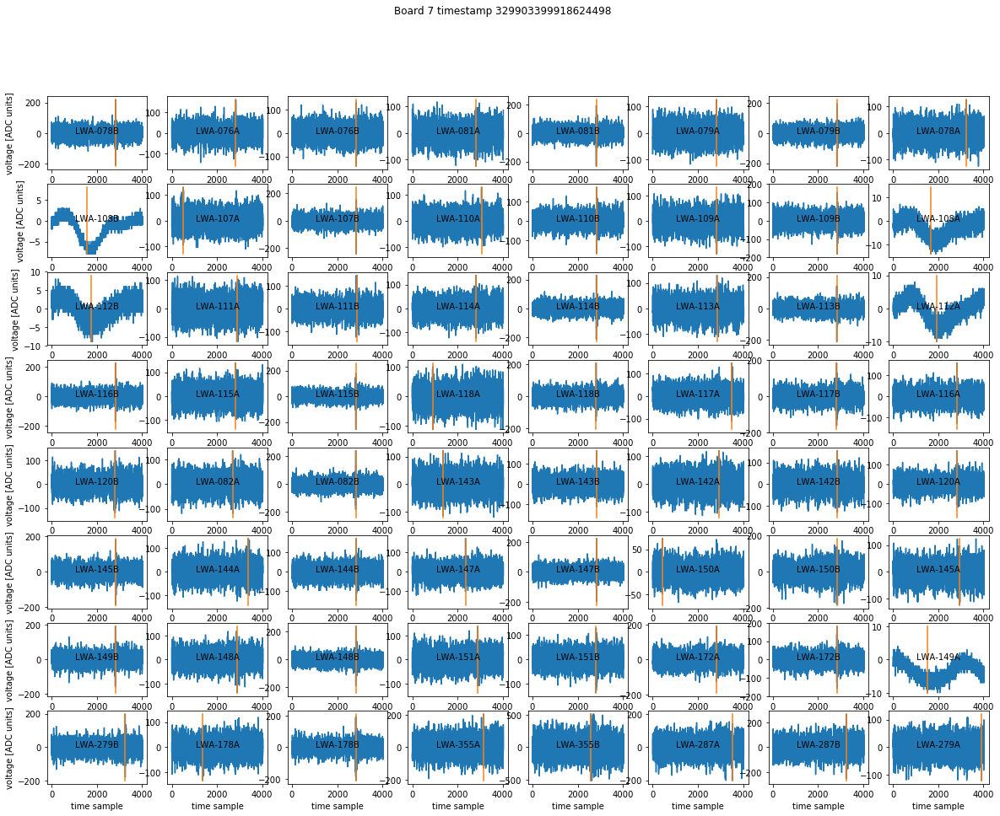

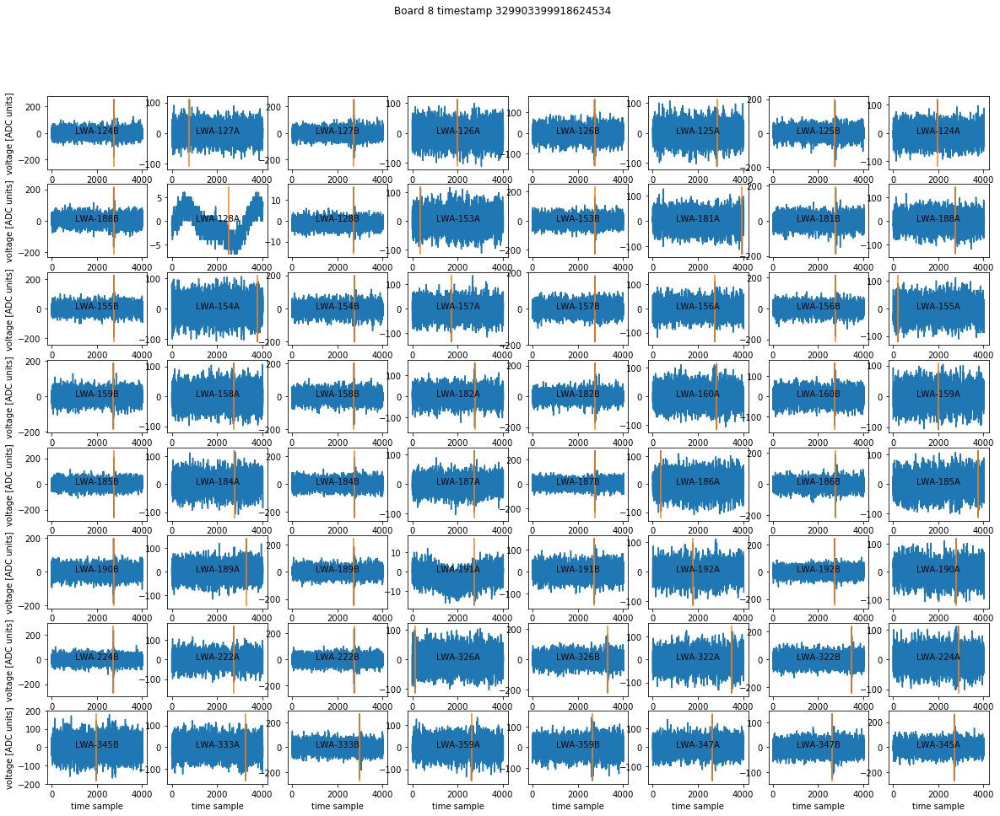

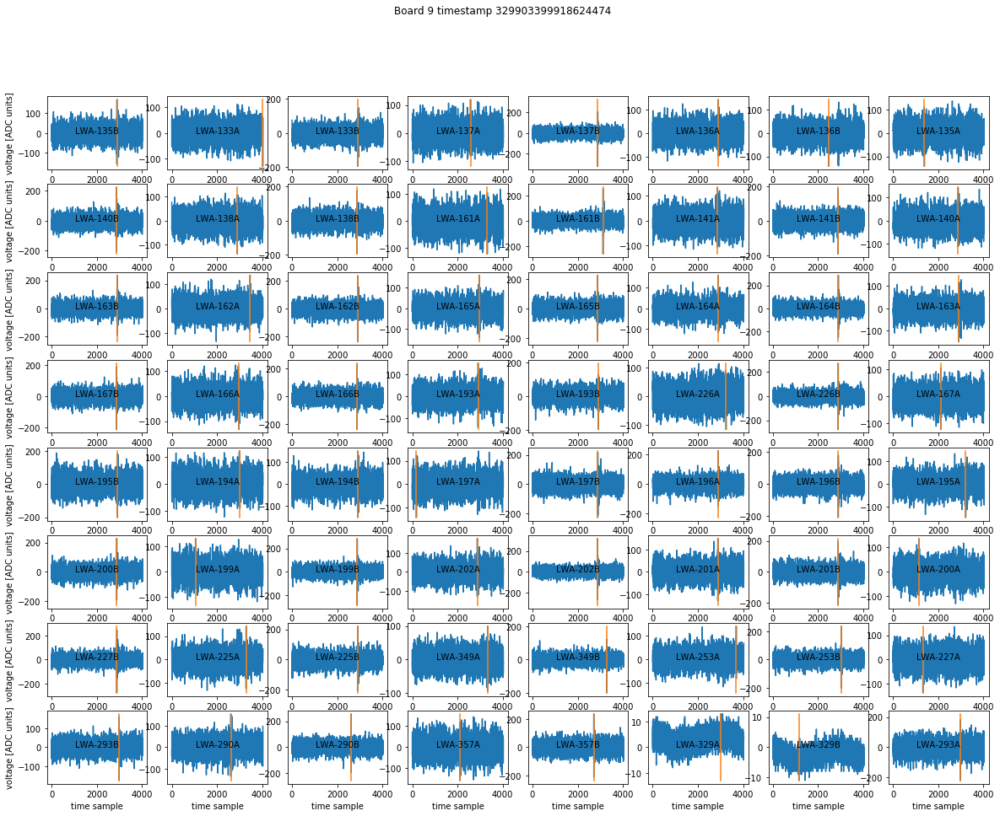

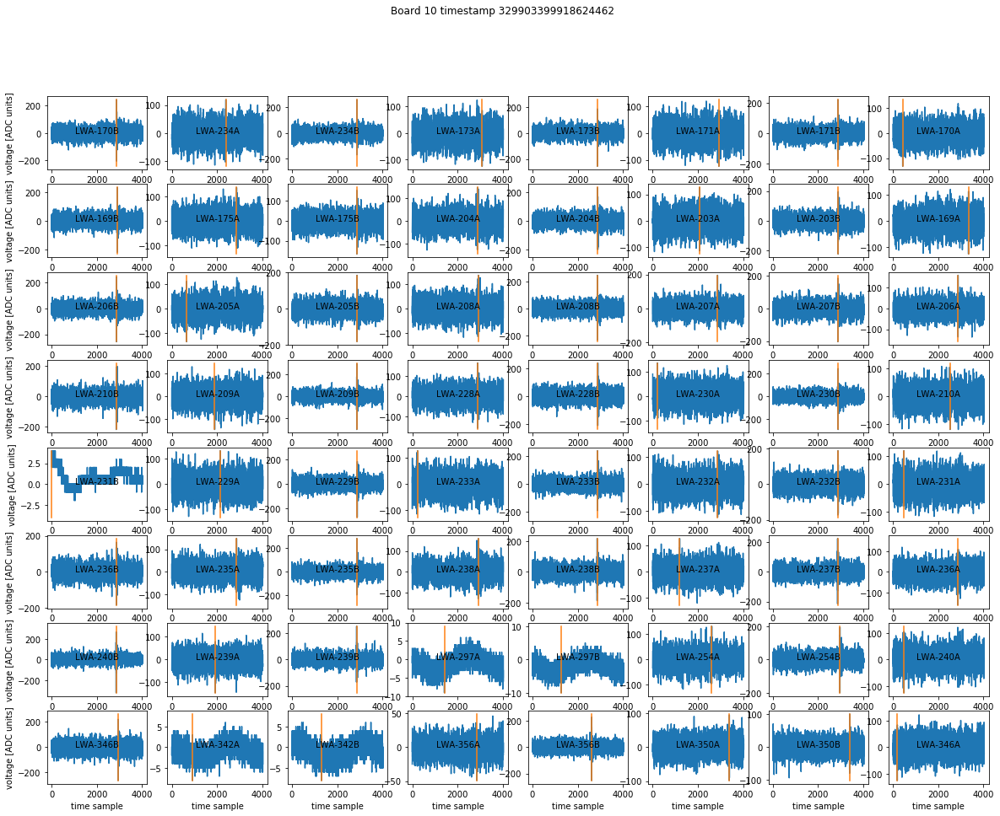

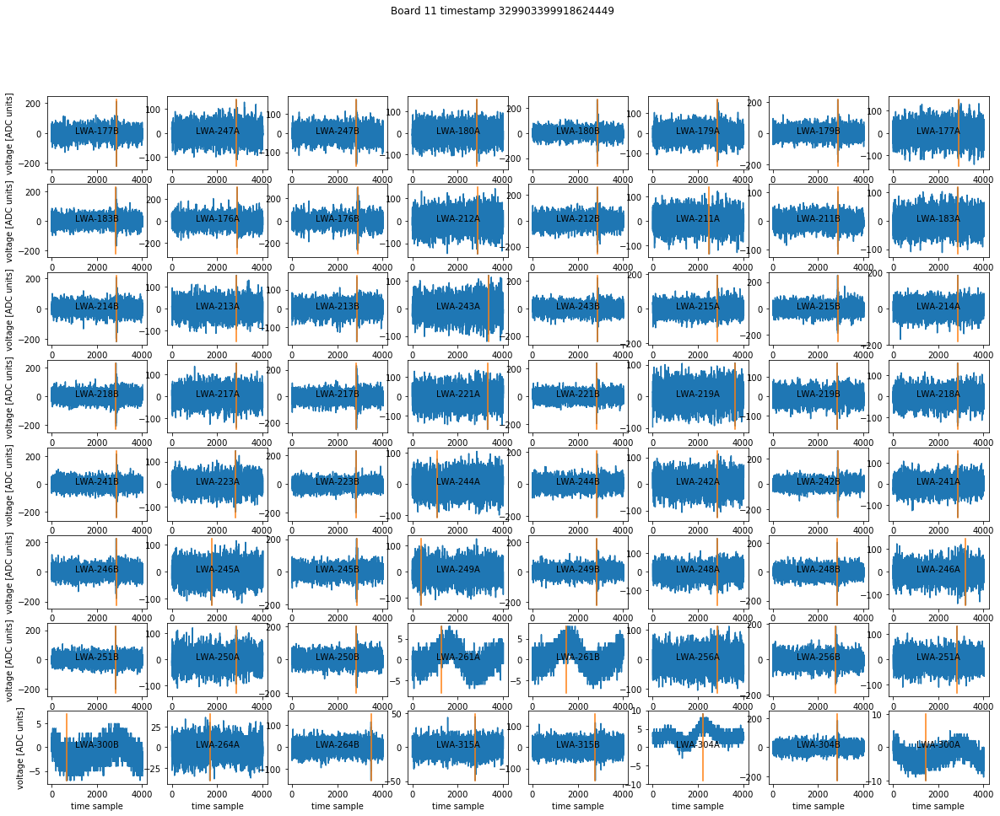

In [149]:
for event in events:
    plot_all_timeseries(event,True)

## Inspect the waveforms for the ring of antennas around the core for event with the best wavefront fit for which these were outliers

I conclude that misidentification does not explain the TOA offsets for these antennas. The event is an isolated pulse.

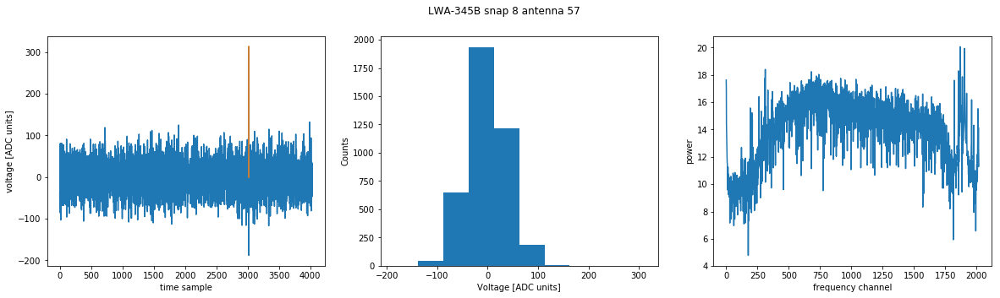

In [188]:
antennas=[mapping.antpol_to_fpga(antname[:-1],antname[-1]) for antname in ['LWA-345B','LWA-361B','LWA-262B','LWA-274B','LWA-294B','LWA-293B']]

plot_select_antennas(events[5],antennas[:1],True)




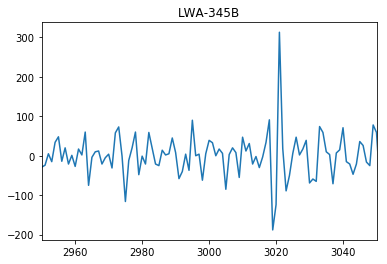

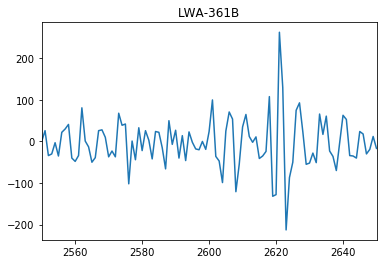

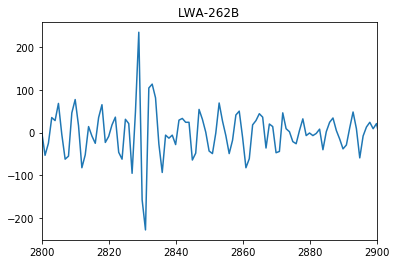

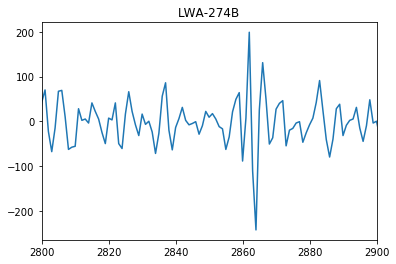

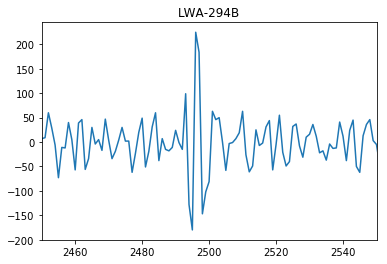

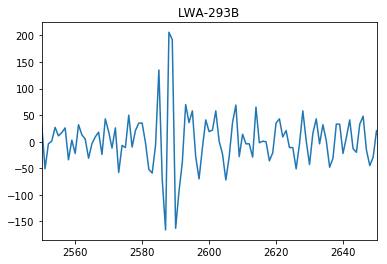

In [198]:
antnames=['LWA-345B','LWA-361B','LWA-262B','LWA-274B','LWA-294B','LWA-293B']
zoomwindows=[[2950,3050],[2550,2650],[2800,2900],[2800,2900],[2450,2550],[2550,2650]]
for i,a in enumerate(antnames):
    plt.figure()
    plt.title(a)
    for record in events[5]:
        if record['antname']==a:
            plt.plot(record['data'])
        plt.xlim(zoomwindows[i])

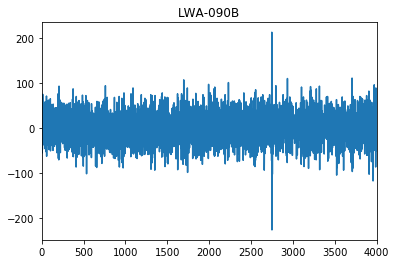

In [200]:
#same thing but for an example core antenna
antnames=['LWA-090B',]
zoomwindows=[[0,4000]]
for i,a in enumerate(antnames):
    plt.figure()
    plt.title(a)
    for record in events[5]:
        if record['antname']==a:
            plt.plot(record['data'])
        plt.xlim(zoomwindows[i])

## Compare waveforms for all events, for a few antennas

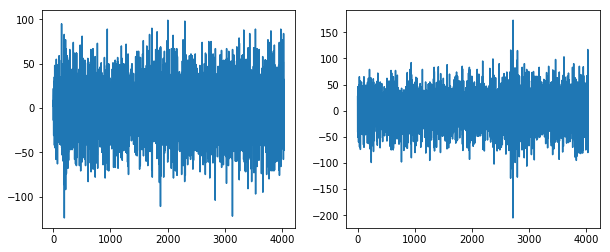

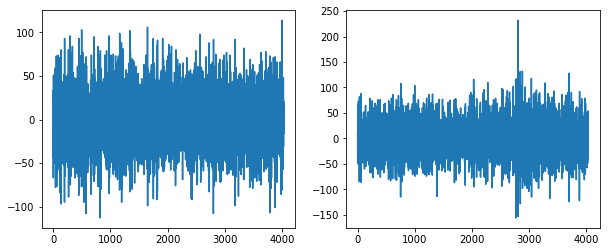

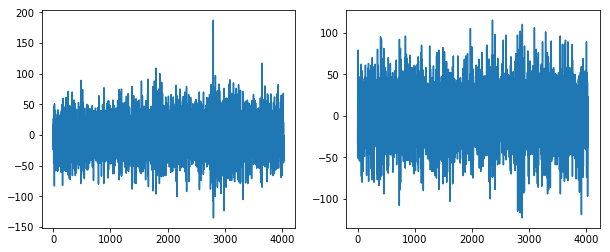

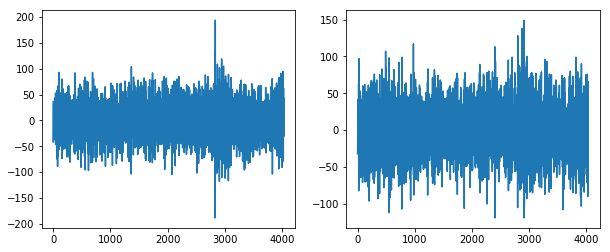

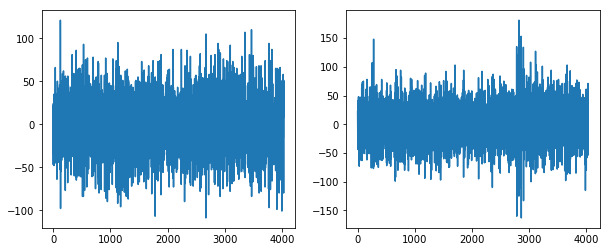

...

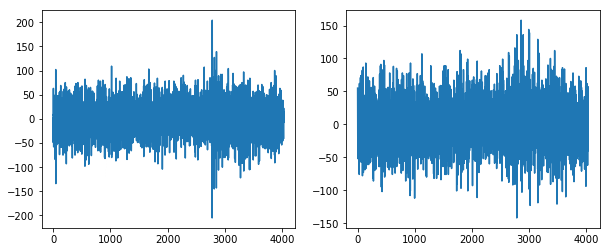

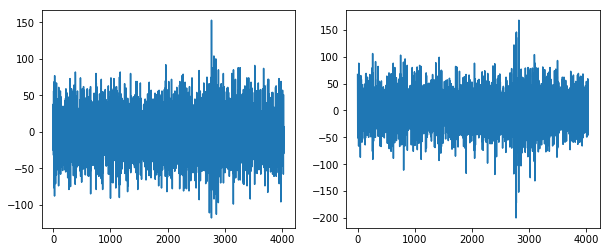

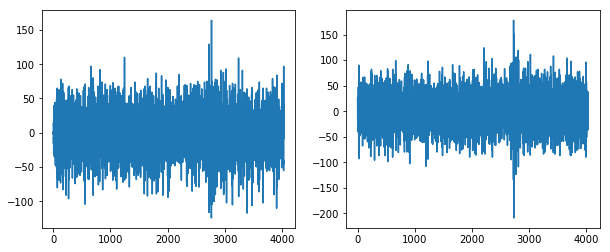

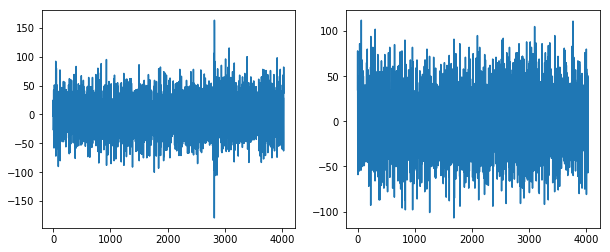

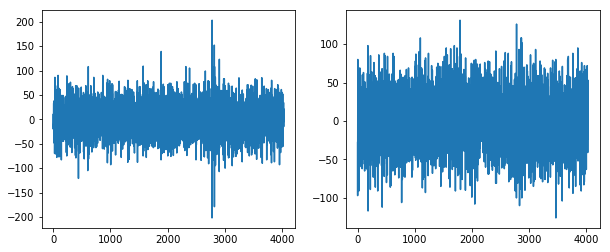

In [215]:

            
antnames=['LWA-090','LWA-050']            
for e, event in enumerate(events):
    mergedrecords=mergepolarizations(event)
    for i,a in enumerate(antnames):
        plt.figure(figsize=(10,4))
        plt.title(a+" event "+str(e))
        for record in mergedrecords:
            if record['antname']==a:
                plt.subplot(121)
                plt.plot(record['polA_data'])
                plt.subplot(122)
                plt.plot(record['polB_data'])


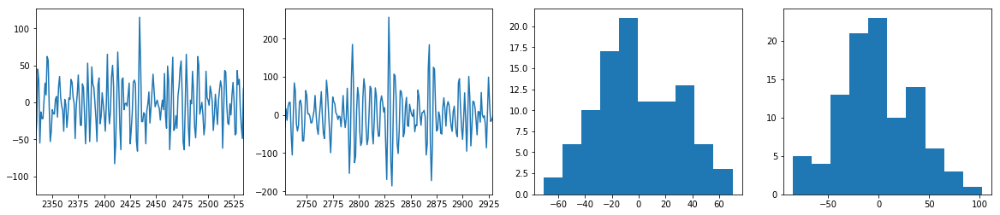

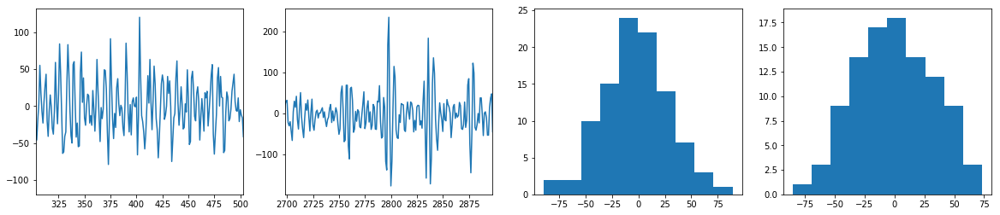

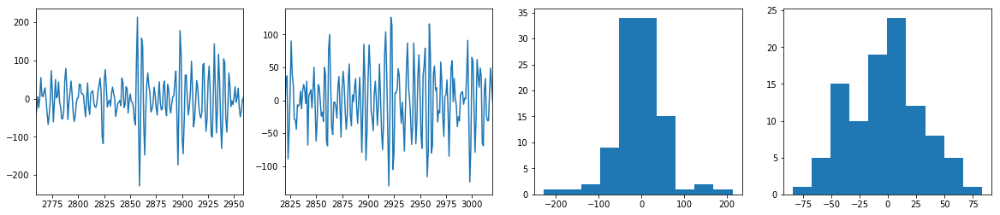

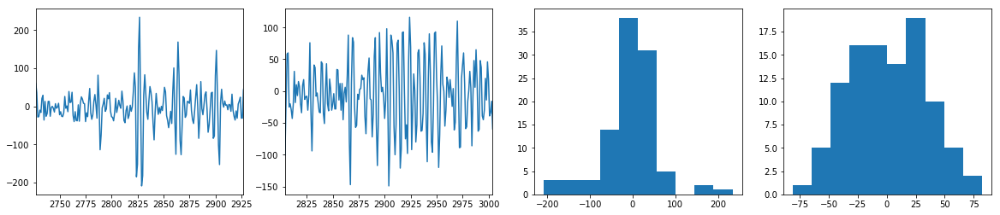

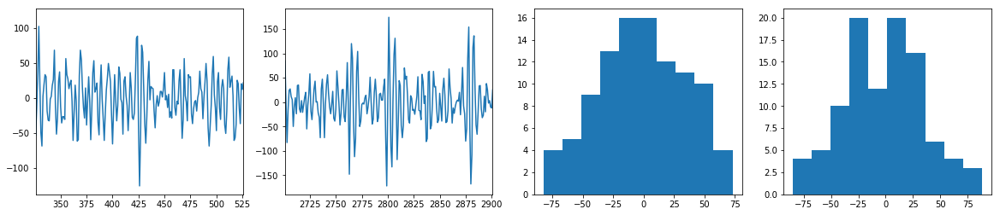

...

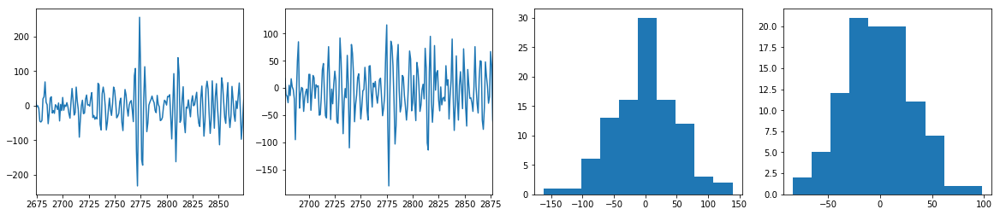

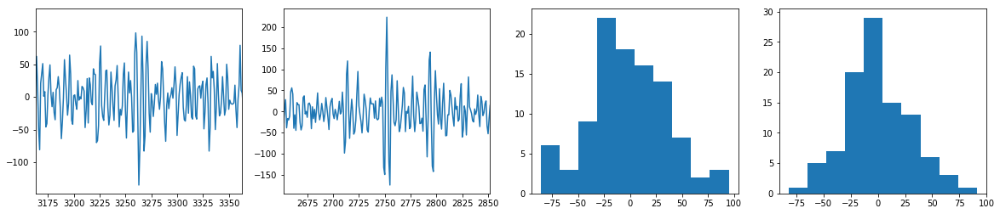

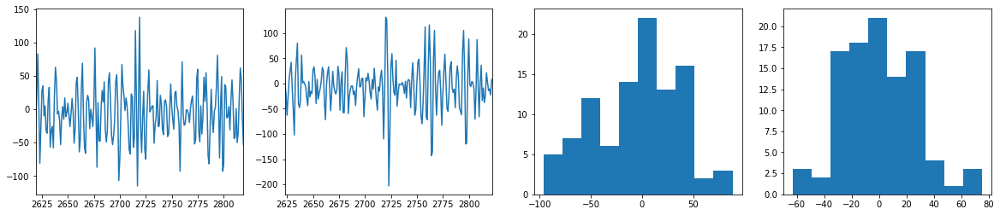

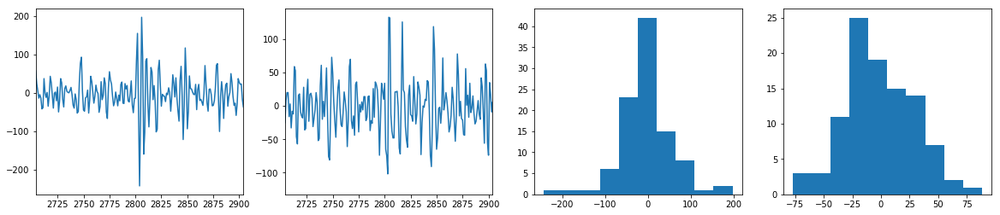

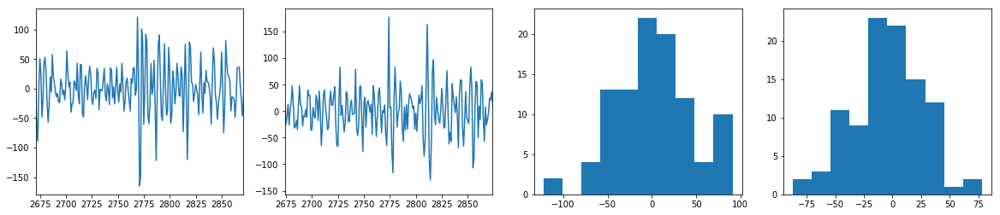

In [225]:
antnames=['LWA-045','LWA-020']            
for e, event in enumerate(events):
    mergedrecords=mergepolarizations(event)
    for i,a in enumerate(antnames):
        plt.figure(figsize=(20,4))
        plt.title(a+" event "+str(e))
        for record in mergedrecords:
            if record['antname']==a:
                plt.subplot(141)
                plt.plot(record['polA_data'])
                plt.xlim(record['index_peak_A']-100,record['index_peak_A']+100)
                plt.subplot(142)
                plt.plot(record['polB_data'])
                plt.xlim(record['index_peak_B']-100,record['index_peak_B']+100)
                plt.subplot(143)
                plt.hist(record['polA_data'][indexA:indexA+100])
                plt.subplot(144)
                plt.hist(record['polB_data'][indexB:indexB+100])

In [229]:
antnames=['LWA-045','LWA-020']            
for e, event in enumerate(events):
    mergedrecords=mergepolarizations(event)
    for i,a in enumerate(antnames):
        for record in mergedrecords:
            if record['antname']==a:
                indexA=record['index_peak_A']
                indexB=record['index_peak_B']
                peakA=record['peakA']
                peakB=record['peakB']
                rms_beginning_A=np.std(record['polA_data'][:2000])
                rms_afterA=np.std(record['polA_data'][indexA+10:indexA+60])
                rms_beginning_B=np.std(record['polB_data'][:2000])
                rms_afterB=np.std(record['polB_data'][indexB+10:indexB+60])
                
                nsub_peaksA=np.sum(record['polA_data']>0.7*peakA)
                nsub_peaksB=np.sum(record['polA_data']>0.7*peakB)

                print('pol A',peakA/rms_beginning_A,rms_afterA/rms_beginning_A,nsub_peaksA)
                print('pol B',peakB/rms_beginning_B,rms_afterB/rms_beginning_B,nsub_peaksB)

pol A 3.479954949839675 1.0290536322223791 37
pol B 7.987454295988754 1.890192023056615 0
pol A 3.652641679436101 1.0206437762997553 20
pol B 7.207727280396748 1.823327326890111 0
pol A 7.380531190705565 1.9221926080080962 2
pol B 4.230246581925813 1.7176052629264096 27
pol A 6.933084442161628 1.598584010843271 2
pol B 4.387742300025066 1.908844124510958 8
pol A 3.6891133006428305 0.7062417457355643 15
pol B 5.316192458842287 1.269810469705072 0
pol A 3.6720342908146613 0.8317701841614515 28
pol B 5.493633798378029 1.4031593670311178 0
pol A 7.329007485905467 1.1984523897907104 1
pol B 4.140292974706104 0.8157512667027674 30
pol A 5.5992006224668005 1.1917030454610098 5
pol B 5.085627119416609 1.2819067955362953 7
pol A 4.1483765179077565 1.136716439509198 11
pol B 7.223741848739423 2.01359997141713 0
pol A 3.9140590006869656 1.0092498881810714 14
pol B 6.998902971272772 1.9327442699387594 0
pol A 3.9034415920593237 0.813077884859634 15
pol B 6.1114344487092245 1.3606827164585977 0
pol

## How many vetos of each polarization were available?

In [ ]:
for r in mergedrecords:
    print(r['board_id'],r['this_board_triggered'],r['coincidence_window'],r['trigger_power_threshold'],r['coincidence_threshold'],r['veto_coincidence_window'],r['veto_power_threshold'],r['veto_threshold'])

In [232]:
polA_veto_count5=0
polB_veto_count5=0
polA_veto_count8=0
polB_veto_count8=0
for r in mergedrecords:
    if r['veto_threshold']==2:
        if r['board_id']==5:
            polA_veto_count5+=r['veto_role_A']
            polB_veto_count5+=r['veto_role_B']
            if r['veto_role_A']==1:
                print(r['antname'])
            if r['veto_role_B']==1:
                print(r['antname'])
        elif r['board_id']==8:
            polA_veto_count8+=r['veto_role_A']
            polB_veto_count8+=r['veto_role_B']
            if r['veto_role_A']==1:
                print(r['antname'])
            if r['veto_role_B']==1:
                print(r['antname'])
                print(r['veto_power_threshold'])
print(polA_veto_count5,polB_veto_count5)
print(polA_veto_count8,polB_veto_count8)

LWA-316
LWA-316
LWA-334
LWA-328
LWA-328
LWA-326
LWA-326
(40000,)
LWA-322
(40000,)
LWA-333
LWA-333
(40000,)
3 2
2 3


In [231]:
record.keys()

dict_keys(['antname', 'x', 'y', 'z', 'timestamp', 'board_id', 'this_board_triggered', 'coincidence_threshold', 'veto_threshold', 'trigger_power_threshold', 'veto_power_threshold', 'coincidence_window', 'veto_coincidence_window', 'trigger_role_A', 'antenna_id_A', 'veto_role_A', 'polA_data', 'rmsA', 'index_peak_A', 'peakA', 'trigger_role_B', 'antenna_id_B', 'veto_role_B', 'polB_data', 'rmsB', 'index_peak_B', 'peakB'])

In [233]:
40000**0.5

200.0